In [1]:
import numpy as np
import xgcm
from xgcm import Grid
from xhistogram.xarray import histogram
import xarray as xr
import xroms
from scipy import signal
import glob
import functions #the .py file that contains all the relevant functions
from datetime import datetime

import warnings
import cartopy
import cartopy.crs as ccrs
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import cartopy.feature as cfeature
import cmocean.cm as cmo
import matplotlib.pyplot as plt
from matplotlib import colors
from matplotlib import ticker
from matplotlib.dates import DateFormatter
from mpl_toolkits.axes_grid1 import make_axes_locatable
plt.rcParams.update({'font.size': 12})

import warnings
warnings.filterwarnings("ignore")
from celluloid import Camera
from IPython.display import HTML

In [29]:
# svarhr = xr.open_mfdataset('/scratch/user/dylan.schlichting/tef/largecv/histograms/svar/*.nc')
# salthr = xr.open_mfdataset('/scratch/user/dylan.schlichting/tef/largecv/histograms/salt/*.nc')
# volhr = xr.open_mfdataset('/scratch/user/dylan.schlichting/tef/largecv/histograms/vol/*.nc')

#xr.merge([svarhr, salthr, volhr]).to_netcdf('/scratch/user/dylan.schlichting/tef/largecv/histograms/Qcombh_2010.nc')
# xr.open_mfdataset('/scratch/user/dylan.schlichting/tef/largecv/histograms/Qcombh_2010.nc')

ds = xr.open_mfdataset('/scratch/user/dylan.schlichting/tef/largecv/histograms/temp_sal/*.nc') #Change the path if necessary
ds = functions.exchange_flow(ds)

ds.attrs['Description'] = 'Exchange flow Dataset'
ds.attrs['Author'] = 'Dylan Schlichting'
ds.attrs['Created'] = datetime.now().isoformat()
ds.attrs['Grid'] = 'xi points: '+str(xislice)+', eta points: '+str(etaslice)

ds.to_netcdf('/scratch/user/dylan.schlichting/tef/largecv/budgets/tef_hourly_ts2d_2010.nc', engine = 'h5netcdf')
print('Exchange flow saved')

Exchange flow saved


In [1]:
tefts = xr.open_dataset('/scratch/user/dylan.schlichting/tef/largecv/budgets/tef_hourly_ts2d_2010.nc')
chits = xr.open_mfdataset('/scratch/user/dylan.schlichting/tef/largecv/budgets/chi_hourly_2010_ts.nc')

NameError: name 'xr' is not defined

In [3]:
tempbins = np.linspace(0,40,501)
saltbins = np.linspace(0,40,501)
T,S = np.meshgrid(tempbins, saltbins)

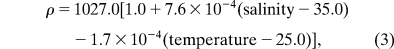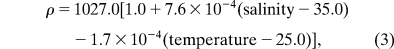

In [5]:
rho = 1027.0*((1+7.6*10**(-4)*(S-35))-(1.7*10**(-4)*(T-25)))-1000

In [39]:
t.sel(ocean_time = slice('2010-06', '2010-08')).to_netcdf('/scratch/user/dylan.schlichting/tef/largecv/budgets/chi_unitvolume_hourly_2010.nc')

In [5]:
path = '/scratch/user/dylan.schlichting/tef/largecv/budgets/chi_unitvolume_hourly_2010.nc'
chidv = xr.open_dataset(path)
chidv

<xarray.Dataset>
Dimensions:     (ocean_time: 2208, salt_bin: 500, temp_bin: 500)
Coordinates:
  * ocean_time  (ocean_time) datetime64[ns] 2010-06-01 ... 2010-08-31T23:00:00
  * salt_bin    (salt_bin) float64 0.04 0.12 0.2 0.28 ... 39.72 39.8 39.88 39.96
  * temp_bin    (temp_bin) float64 0.04 0.12 0.2 0.28 ... 39.72 39.8 39.88 39.96
Data variables:
    chi         (ocean_time, salt_bin, temp_bin) float64 ...

In [9]:
chidv.chi.sum(['ocean_time', 'temp_bin']).max()

<xarray.DataArray 'chi' ()>
array(19.29372973)

In [11]:
chidv.chi.sum(['ocean_time', 'temp_bin'])[355]

<xarray.DataArray 'chi' ()>
array(19.29372973)
Coordinates:
    salt_bin  float64 28.44

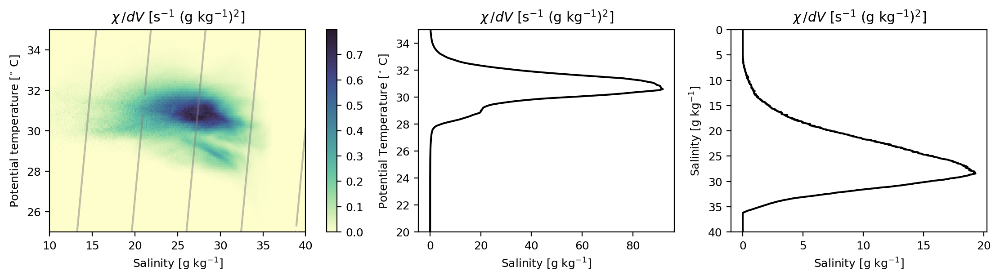

In [67]:
plt.rcParams.update({'font.size': 9})
fig, ax = plt.subplots(1,3, figsize = (11,3), dpi = 200, constrained_layout = True)

chidv.chi.sum('ocean_time').plot(ax = ax[0],
                                y = 'temp_bin', 
                                cmap = cmo.deep, 
                                vmin = 0,
                                cbar_kwargs = {'label': '','pad': 0.020,
                                               'aspect': 70})

ax[0].set_xlim(10,40)
ax[0].set_ylim(25,35)
ax[0].set_xlabel('Salinity [g kg$^{-1}$]')
ax[0].set_ylabel('Potential temperature [$^{\circ}$ C]')
ax[0].set_title('$\chi \, /dV$ [s$^{-1}$ (g kg$^{-1}$)$^2$]')

cs = ax[0].contour(S,T,rho, colors = 'grey', alpha = 0.5)
cl = plt.clabel(cs,fontsize=5,inline=True,fmt='%.1f')

chidv.chi.sum(['ocean_time', 'salt_bin']).plot(ax = ax[1],
                                               y = 'temp_bin', 
                                               color = 'k'
                                                       )

ax[1].set_ylim(20,35)
ax[1].set_ylabel('Potential Temperature [$^{\circ}$ C]')
ax[1].set_xlabel('Salinity [g kg$^{-1}$]')
ax[1].set_title('$\chi \, /dV $ [s$^{-1}$ (g kg$^{-1}$)$^2$]')

chidv.chi.sum(['ocean_time', 'temp_bin']).plot(ax = ax[2],
                                               y = 'salt_bin', 
                                               color = 'k'
                                                       )

ax[2].set_ylim(0,40)
ax[2].set_ylabel('Salinity [g kg$^{-1}$]')
ax[2].set_xlabel('Salinity [g kg$^{-1}$]')
ax[2].set_title('$\chi \, /dV$ [s$^{-1}$ (g kg$^{-1}$)$^2$]')
ax[2].invert_yaxis()

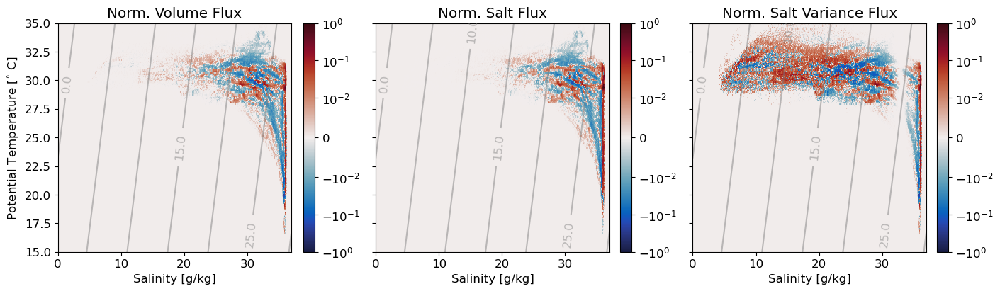

In [7]:
Qnorm = tefts.Qnet.sum('ocean_time')/(tefts.Qnet.sum('ocean_time').max())
Qsnorm = tefts.Qsnet.sum('ocean_time')/(tefts.Qsnet.sum('ocean_time').max())
Qsvarnorm = tefts.Qsvarnet.sum('ocean_time')/(tefts.Qsvarnet.sum('ocean_time').max())

plt.rcParams.update({'font.size': 12})
fig, ax = plt.subplots(1,3, figsize = (14,4), dpi = 100, constrained_layout = True)

m0 = Qnorm.plot(y = 'temp_bin', 
           ax = ax[0],
           cmap = cmo.balance,
           norm=colors.SymLogNorm(linthresh=0.001, linscale=0.1, vmin=-1.0, vmax=1.0),
           add_colorbar=False,)

ax[0].set_xlim(0,37)
ax[0].set_ylim(15,35)
ax[0].set_ylabel('Potential Temperature [$^{\circ}$ C]')
ax[0].set_xlabel('Salinity [g/kg]')
ax[0].set_title('Norm. Volume Flux')

m1 = Qsnorm.plot(y = 'temp_bin', 
            ax = ax[1],
            cmap = cmo.balance,
            norm = colors.SymLogNorm(linthresh=0.001, linscale=0.1, vmin=-1.0, vmax=1.0),
            add_colorbar=False)

ax[1].set_xlim(0,37)
ax[1].set_ylim(15,35)
ax[1].set_ylabel('')
ax[1].set_xlabel('Salinity [g/kg]')
ax[1].set_title('Norm. Salt Flux')
ax[1].axes.yaxis.set_ticklabels([])

m2 = Qsvarnorm.plot(y = 'temp_bin', 
               ax = ax[2],
               cmap = cmo.balance,
               norm = colors.SymLogNorm(linthresh=0.001, linscale=0.1, vmin=-1.0, vmax=1.0),
               add_colorbar=False)

ax[2].set_title('Norm. Salt Variance Flux')
ax[2].set_xlim(0,37)
ax[2].set_ylim(15,35)
ax[2].set_ylabel('')
ax[2].set_xlabel('Salinity [g/kg]')
ax[2].axes.yaxis.set_ticklabels([])

tick_locations = [-1, -0.01, -0.1, 0, 0.01, 0.1, 1]
plt.colorbar(m0, ax = ax[0], aspect = 70, ticks=tick_locations, format=ticker.LogFormatterMathtext())
plt.colorbar(m1, ax = ax[1], aspect = 70, ticks=tick_locations, format=ticker.LogFormatterMathtext())
plt.colorbar(m2, ax = ax[2], aspect = 70, ticks=tick_locations, format=ticker.LogFormatterMathtext())

cs = ax[0].contour(S,T,rho, colors = 'grey', alpha = 0.5)
cl = plt.clabel(cs,fontsize=12,inline=True,fmt='%.1f')

cs = ax[1].contour(S,T,rho, colors = 'grey', alpha = 0.5)
cl = plt.clabel(cs,fontsize=12,inline=True,fmt='%.1f')

cs = ax[2].contour(S,T,rho, colors = 'grey', alpha = 0.5)
cl = plt.clabel(cs,fontsize=12,inline=True,fmt='%.1f')

### Scaled by maximum value during each month

In [ ]:
Qnorm0 = tefts.Qnet.sel(ocean_time = '2010-06').sum('ocean_time')/(tefts.Qnet.sel(ocean_time = '2010-06').sum('ocean_time').max())
Qsnorm0 = tefts.Qsnet.sel(ocean_time = '2010-06').sum('ocean_time')/(tefts.Qsnet.sel(ocean_time = '2010-06').sum('ocean_time').max())
Qsvarnorm0 = tefts.Qsvarnet.sel(ocean_time = '2010-06').sum('ocean_time')/(tefts.Qsvarnet.sel(ocean_time = '2010-06').sum('ocean_time').max())
Qnorm1 = tefts.Qnet.sel(ocean_time = '2010-07').sum('ocean_time')/(tefts.Qnet.sel(ocean_time = '2010-07').sum('ocean_time').max())
Qsnorm1 = tefts.Qsnet.sel(ocean_time = '2010-07').sum('ocean_time')/(tefts.Qsnet.sel(ocean_time = '2010-07').sum('ocean_time').max())
Qsvarnorm1 = tefts.Qsvarnet.sel(ocean_time = '2010-07').sum('ocean_time')/(tefts.Qsvarnet.sel(ocean_time = '2010-07').sum('ocean_time').max())
Qnorm2 = tefts.Qnet.sel(ocean_time = '2010-08').sum('ocean_time')/(tefts.Qnet.sel(ocean_time = '2010-08').sum('ocean_time').max())
Qsnorm2 = tefts.Qsnet.sel(ocean_time = '2010-08').sum('ocean_time')/(tefts.Qsnet.sel(ocean_time = '2010-08').sum('ocean_time').max())
Qsvarnorm2= tefts.Qsvarnet.sel(ocean_time = '2010-08').sum('ocean_time')/(tefts.Qsvarnet.sel(ocean_time = '2010-08').sum('ocean_time').max())

Qnorm = [Qnorm0, Qnorm1, Qnorm2]
Qsnorm = [Qsnorm0, Qsnorm1, Qsnorm2]
Qsvarnorm = [Qsvarnorm0, Qsvarnorm1, Qsvarnorm2]

### Scaled by max value during the entire summer

In [8]:
Qnorm0 = tefts.Qnet.sel(ocean_time = '2010-06').sum('ocean_time')/(tefts.Qnet.sum('ocean_time').max())
Qsnorm0 = tefts.Qsnet.sel(ocean_time = '2010-06').sum('ocean_time')/(tefts.Qsnet.sum('ocean_time').max())
Qsvarnorm0 = tefts.Qsvarnet.sel(ocean_time = '2010-06').sum('ocean_time')/(tefts.Qsvarnet.sum('ocean_time').max())
Qnorm1 = tefts.Qnet.sel(ocean_time = '2010-07').sum('ocean_time')/(tefts.Qnet.sum('ocean_time').max())
Qsnorm1 = tefts.Qsnet.sel(ocean_time = '2010-07').sum('ocean_time')/(tefts.Qsnet.sum('ocean_time').max())
Qsvarnorm1 = tefts.Qsvarnet.sel(ocean_time = '2010-07').sum('ocean_time')/(tefts.Qsvarnet.sum('ocean_time').max())
Qnorm2 = tefts.Qnet.sel(ocean_time = '2010-08').sum('ocean_time')/(tefts.Qnet.sum('ocean_time').max())
Qsnorm2 = tefts.Qsnet.sel(ocean_time = '2010-08').sum('ocean_time')/(tefts.Qsnet.sum('ocean_time').max())
Qsvarnorm2= tefts.Qsvarnet.sel(ocean_time = '2010-08').sum('ocean_time')/(tefts.Qsvarnet.sum('ocean_time').max())

Qnorm = [Qnorm0, Qnorm1, Qnorm2]
Qsnorm = [Qsnorm0, Qsnorm1, Qsnorm2]
Qsvarnorm = [Qsvarnorm0, Qsvarnorm1, Qsvarnorm2]

Text(0.5, 1.0, 'Norm. Salt Variance Flux')

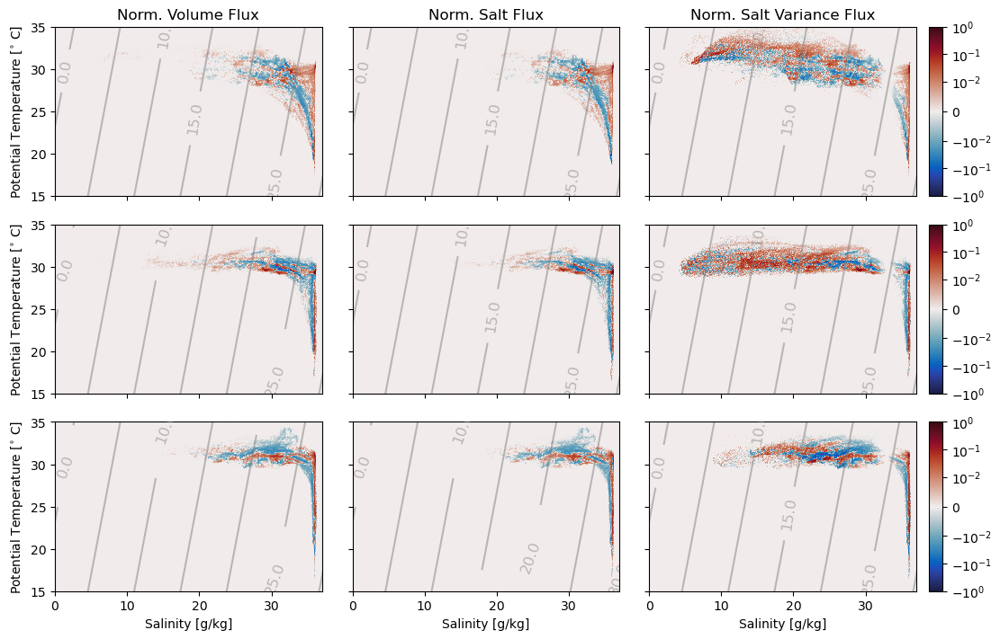

In [9]:
plt.rcParams.update({'font.size': 10})
fig, ax = plt.subplots(3,3, figsize = (11,7), dpi = 100, constrained_layout = True)

for item in range(3):
    m0 = Qnorm[item].plot(y = 'temp_bin', 
               ax = ax[item,0],
               cmap = cmo.balance,
               norm=colors.SymLogNorm(linthresh=0.001, linscale=0.1, vmin=-1.0, vmax=1.0),
               add_colorbar=False,)

    ax[item,0].set_xlim(0,37)
    ax[item,0].set_ylim(15,35)
    ax[item,0].set_ylabel('Potential Temperature [$^{\circ}$ C]')

    m1 = Qsnorm[item].plot(y = 'temp_bin', 
                ax = ax[item,1],
                cmap = cmo.balance,
                norm = colors.SymLogNorm(linthresh=0.001, linscale=0.1, vmin=-1.0, vmax=1.0),
                add_colorbar=False)

    ax[item,1].set_xlim(0,37)
    ax[item,1].set_ylim(15,35)
    ax[item,1].set_ylabel('')
    ax[item,1].axes.yaxis.set_ticklabels([])

    m2 = Qsvarnorm[item].plot(y = 'temp_bin', 
                   ax = ax[item,2],
                   cmap = cmo.balance,
                   norm = colors.SymLogNorm(linthresh=0.001, linscale=0.1, vmin=-1.0, vmax=1.0),
                   add_colorbar=False)

    ax[item,2].set_xlim(0,37)
    ax[item,2].set_ylim(15,35)
    ax[item,2].set_ylabel('')

    ax[item,2].axes.yaxis.set_ticklabels([])

    tick_locations = [-1, -0.01, -0.1, 0, 0.01, 0.1, 1]
    cb = plt.colorbar(m0, ax = ax[item,0], aspect = 50, ticks=tick_locations, format=ticker.LogFormatterMathtext())
    cb.remove()
    cb = plt.colorbar(m1, ax = ax[item,1], aspect = 50, ticks=tick_locations, format=ticker.LogFormatterMathtext())
    cb.remove()
    plt.colorbar(m2, ax = ax[item,2], aspect = 20, ticks=tick_locations, format=ticker.LogFormatterMathtext())
    
    cs = ax[0,item].contour(S,T,rho, colors = 'grey', alpha = 0.5)
    cl = plt.clabel(cs,fontsize=12,inline=True,fmt='%.1f')

    cs = ax[1,item].contour(S,T,rho, colors = 'grey', alpha = 0.5)
    cl = plt.clabel(cs,fontsize=12,inline=True,fmt='%.1f')

    cs = ax[2,item].contour(S,T,rho, colors = 'grey', alpha = 0.5)
    cl = plt.clabel(cs,fontsize=12,inline=True,fmt='%.1f')
    
   
ax[0,0].axes.xaxis.set_ticklabels([])
ax[0,1].axes.xaxis.set_ticklabels([])
ax[0,2].axes.xaxis.set_ticklabels([])
ax[1,0].axes.xaxis.set_ticklabels([])
ax[1,1].axes.xaxis.set_ticklabels([])
ax[1,2].axes.xaxis.set_ticklabels([])

ax[0,0].axes.set_xlabel('')
ax[0,1].axes.set_xlabel('')
ax[0,2].axes.set_xlabel('')
ax[1,0].axes.set_xlabel('')
ax[1,1].axes.set_xlabel('')
ax[1,2].axes.set_xlabel('')

ax[2,1].set_xlabel('Salinity [g/kg]')
ax[2,0].set_xlabel('Salinity [g/kg]')
ax[2,2].set_xlabel('Salinity [g/kg]')

ax[0,0].set_title('Norm. Volume Flux')
ax[0,1].set_title('Norm. Salt Flux')
ax[0,2].set_title('Norm. Salt Variance Flux')

In [97]:
# chinorm0 = chidv.chi.sel(ocean_time = '2010-06').sum('ocean_time')/(chidv.chi.sum('ocean_time').max())
# chinorm1 = chidv.chi.sel(ocean_time = '2010-07').sum('ocean_time')/(chidv.chi.sum('ocean_time').max())
# chinorm2 = chidv.chi.sel(ocean_time = '2010-08').sum('ocean_time')/(chidv.chi.sum('ocean_time').max())

# chinormt0 = chidv.chi.sel(ocean_time = '2010-06').sum(['ocean_time', 'salt_bin'])/(chidv.chi.sum(['ocean_time','salt_bin']).max())
# chinormt1 = chidv.chi.sel(ocean_time = '2010-07').sum(['ocean_time', 'salt_bin'])/(chidv.chi.sum(['ocean_time','salt_bin']).max())
# chinormt2 = chidv.chi.sel(ocean_time = '2010-08').sum(['ocean_time', 'salt_bin'])/(chidv.chi.sum(['ocean_time','salt_bin']).max())

# chinorms0 = chidv.chi.sel(ocean_time = '2010-06').sum(['ocean_time', 'temp_bin'])/(chidv.chi.sum(['ocean_time','temp_bin']).max())
# chinorms1 = chidv.chi.sel(ocean_time = '2010-07').sum(['ocean_time', 'temp_bin'])/(chidv.chi.sum(['ocean_time','temp_bin']).max())
# chinorms2 = chidv.chi.sel(ocean_time = '2010-08').sum(['ocean_time', 'temp_bin'])/(chidv.chi.sum(['ocean_time','temp_bin']).max())

# chinorm = [chinorm0, chinorm1, chinorm2]
# chinormt = [chinormt0, chinormt1, chinormt2]
# chinorms = [chinorms0, chinorms1, chinorms2]

chinorm0 = chidv.chi.sel(ocean_time = '2010-06').sum('ocean_time')/(chidv.chi.sum('ocean_time').max())
chinorm1 = chidv.chi.sel(ocean_time = '2010-07').sum('ocean_time')/(chidv.chi.sum('ocean_time').max())
chinorm2 = chidv.chi.sel(ocean_time = '2010-08').sum('ocean_time')/(chidv.chi.sum('ocean_time').max())

chinormt0 = chidv.chi.sel(ocean_time = '2010-06').sum(['ocean_time', 'salt_bin'])/(chidv.chi.sum(['ocean_time','salt_bin']).max())
chinormt1 = chidv.chi.sel(ocean_time = '2010-07').sum(['ocean_time', 'salt_bin'])/(chidv.chi.sum(['ocean_time','salt_bin']).max())
chinormt2 = chidv.chi.sel(ocean_time = '2010-08').sum(['ocean_time', 'salt_bin'])/(chidv.chi.sum(['ocean_time','salt_bin']).max())

chinorms0 = chidv.chi.sel(ocean_time = '2010-06').sum(['ocean_time', 'temp_bin'])/(chidv.chi.sum(['ocean_time','temp_bin']).max())
chinorms1 = chidv.chi.sel(ocean_time = '2010-07').sum(['ocean_time', 'temp_bin'])/(chidv.chi.sum(['ocean_time','temp_bin']).max())
chinorms2 = chidv.chi.sel(ocean_time = '2010-08').sum(['ocean_time', 'temp_bin'])/(chidv.chi.sum(['ocean_time','temp_bin']).max())

chinorm = [chinorm0, chinorm1, chinorm2]
chinormt = [chinormt0, chinormt1, chinormt2]
chinorms = [chinorms0, chinorms1, chinorms2]

Text(0.5, 0, '')

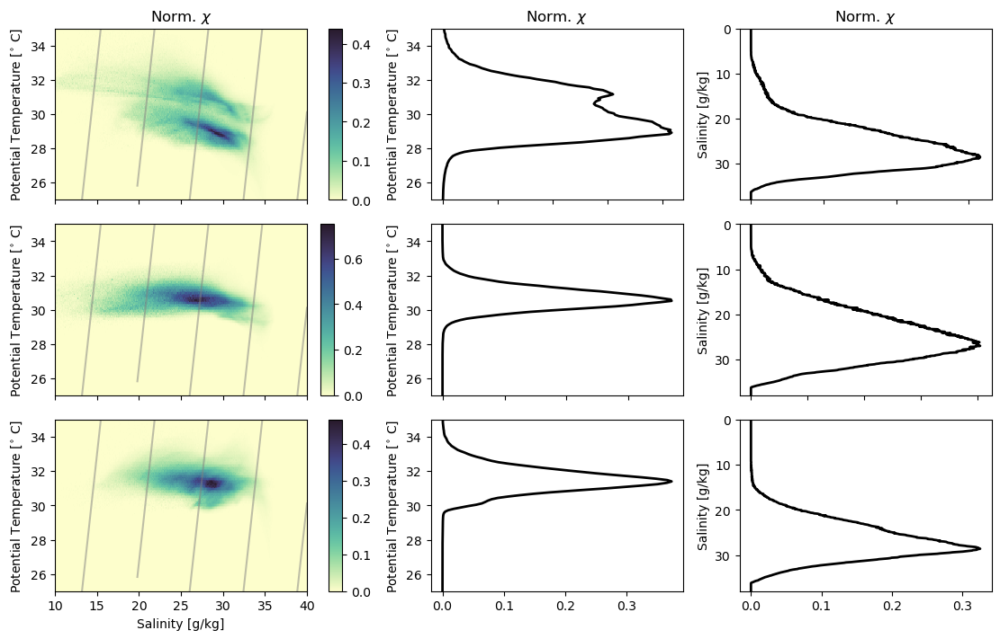

In [111]:
plt.rcParams.update({'font.size': 10})
fig, ax = plt.subplots(3,3, figsize = (11,7), dpi = 100, constrained_layout = True)

for item in range(3):
    m0 = chinorm[item].plot(y = 'temp_bin', 
                            ax = ax[item,0],
                            cmap = cmo.deep,
                            cbar_kwargs = {'label': ''}
                           )

    ax[item,0].set_xlim(10,40)
    ax[item,0].set_ylim(25,35)
    ax[item,0].set_ylabel('Potential Temperature [$^{\circ}$ C]')
    
    cs = ax[item,0].contour(S,T,rho, colors = 'grey', alpha = 0.5)
    cl = plt.clabel(cs,fontsize=12,inline=True,fmt='%.1f', manual = False)

    m1 = chinormt[item].plot(y = 'temp_bin', 
                           ax = ax[item,1], color = 'k', lw = 2)

    ax[item,1].set_ylim(25,35)
    ax[item,1].set_ylabel('')
    ax[item,1].set_ylabel('Potential Temperature [$^{\circ}$ C]')

    m2 = chinorms[item].plot(y = 'salt_bin', 
                              ax = ax[item,2], color = 'k', lw = 2)

    ax[item,2].set_ylim(0,38)
    ax[item,2].set_ylabel('Salinity [g/kg]')
   
ax[0,0].axes.xaxis.set_ticklabels([])
ax[0,1].axes.xaxis.set_ticklabels([])
ax[0,2].axes.xaxis.set_ticklabels([])
ax[1,0].axes.xaxis.set_ticklabels([])
ax[1,1].axes.xaxis.set_ticklabels([])
ax[1,2].axes.xaxis.set_ticklabels([])

ax[0,0].axes.set_xlabel('')
ax[0,1].axes.set_xlabel('')
ax[0,2].axes.set_xlabel('')
ax[1,0].axes.set_xlabel('')
ax[1,1].axes.set_xlabel('')
ax[1,2].axes.set_xlabel('')

ax[0,2].invert_yaxis()
ax[1,2].invert_yaxis()
ax[2,2].invert_yaxis()

ax[0,0].set_title('Norm. $\chi$')
ax[0,1].set_title('Norm. $\chi$')
ax[0,2].set_title('Norm. $\chi$')

ax[2,0].set_xlabel('Salinity [g/kg]')
ax[2,1].set_xlabel('')
ax[2,2].set_xlabel('')

In [10]:
test = xr.open_mfdataset('/scratch/user/dylan.schlichting/tef/largecv/budgets/vint_hourly_2010_ts.nc')
np.shape(test.histogram_salt_temp.sum('ocean_time').values)

(500, 500)

In [11]:
saltbins = np.linspace(0,40,501)
tempbins = np.linspace(0,40,501)

test = xr.open_mfdataset('/scratch/user/dylan.schlichting/tef/largecv/budgets/vint_hourly_2010_ts.nc')
test1 = xr.open_mfdataset('/scratch/user/dylan.schlichting/tef/largecv/budgets/zrh_hourly_2010_ts.nc')

Text(0.5, 0, 'Salinity [g/kg]')

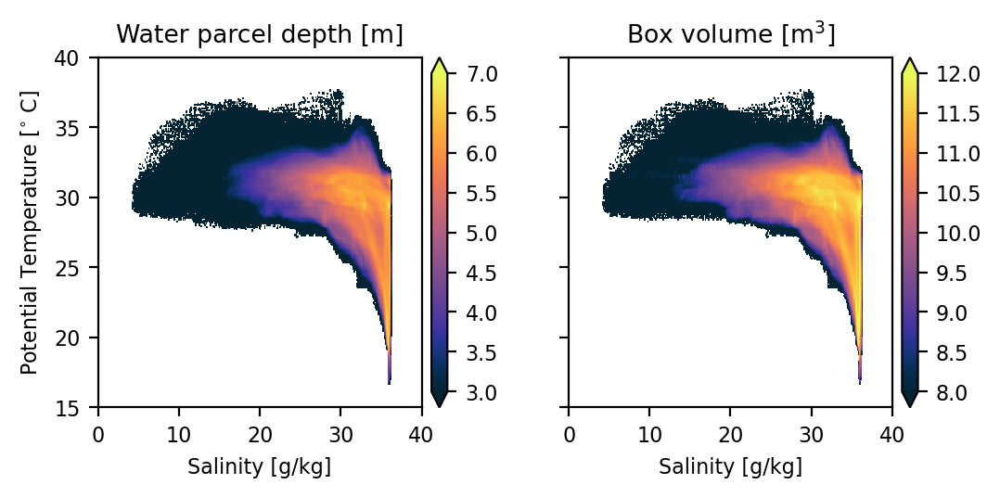

In [27]:
plt.rcParams.update({'font.size': 8})
fig, ax = plt.subplots(1,2, figsize = (6,2.5), dpi = 200)

p1 = -test1.histogram_salt_temp.sum('ocean_time')
p2 = test.histogram_salt_temp.sum('ocean_time')

np.log10(p1).plot(ax = ax[0],
                 y = 'temp_bin', 
                 cmap = cmo.thermal, 
                 vmin = 3, vmax = 7,
                 cbar_kwargs = {'label': '',
                           'pad': 0.025})

np.log10(p2).plot(ax = ax[1],
                 y = 'temp_bin', 
                 cmap = cmo.thermal, 
                 vmin = 8, vmax = 12,
                 cbar_kwargs = {'label': '',
                           'pad': 0.025})
ax[0].set_xlabel('')
ax[0].set_title('Water parcel depth [m]')
ax[0].set_ylim(15,40)
ax[0].set_xlabel('Salinity [g/kg]')
ax[0].set_ylabel('Potential Temperature [$^{\circ}$ C]')

ax[1].set_ylabel('')
ax[1].set_ylim(15,40)
ax[1].set_title('Box volume [m$^3$]')
ax[1].axes.yaxis.set_ticklabels([])
ax[1].set_xlabel('Salinity [g/kg]')

In [3]:
test = xr.open_mfdataset('/scratch/user/dylan.schlichting/tef/largecv/budgets/vint_hourly_2010_ts.nc')`za

In [ ]:
fig, ax = plt.subplots(2, figsize = (14,8), constrained_layout = True, dpi = 200)

np.log10(volhists.dV_saltcoord).plot(ax = ax[0],
                                     y = 'salt_bin', 
                                     cmap = cmo.thermal, 
                                     vmin = 7, vmax = 11,
                                     cbar_kwargs = {'label': '',
                                               'pad': 0.025})

np.log10(volhists.dVs_saltcoord).plot(ax = ax[1],
                                     y = 'salt_bin', 
                                     cmap = cmo.thermal, 
                                     vmin = 7, vmax = 12,
                                    cbar_kwargs = {'label': '',
                                               'pad': 0.025})
ax[0].invert_yaxis()
ax[0].set_xlabel('')
ax[0].set_title('Integrated Volume [m$^3$]')
ax[0].set_ylabel('Salinity [g/kg]')
ax[0].axes.xaxis.set_ticklabels([])

ax[1].invert_yaxis()
ax[1].set_xlabel('')
ax[1].set_title('Integrated Salinity [(g/kg) m$^3$]')
ax[1].set_ylabel('Salinity [g/kg]')

### Look at the isoslices from the control volume.

### Open the following netcdf files: Dissipation of salinity variance, storage terms, tef, river forcing, surface forcing, and TXLA model output

In [2]:
chi = xr.open_dataset('/scratch/user/dylan.schlichting/tef/largecv/budgets/chi_hourly_2010_highres.nc').chi
storage = xr.open_dataset('/scratch/user/dylan.schlichting/tef/largecv/budgets/storage_hourly_2010.nc')
tef = xr.open_dataset('/scratch/user/dylan.schlichting/tef/largecv/budgets/tef_2010_hourly_highres.nc')

path = '/scratch/user/dylan.schlichting/TXLA_Outputs/parent/2010/forcing/txla2_river_2010_AR_newT_SWpass_weekly.nc'
riverds = xr.open_dataset(path).sel(river_time = '2010') #for some reason the last day of 2009 is here, needs to be trimmed
streamflow = np.abs(riverds.river_transport).sum('river')

path = '/scratch/user/dylan.schlichting/TXLA_Outputs/parent/2010/forcing/txla_bulk_ERAI_2010.nc'
surfaceds = xr.open_dataset(path).sel(time = '2010')

paths = glob.glob('../../../dylan.schlichting/TXLA_Outputs/parent/2010/ocean_his_00*.nc')

ds = xroms.open_mfnetcdf(paths, 
                         chunks = {'ocean_time':1})
ds, grid = xroms.roms_dataset(ds, 
                              Vtransform = None)

xislice=slice(260,381) 
etaslice=slice(47,149)

In [2]:
#Surface fluxes
swflux = surfaceds.swflux.isel(eta_rho = etaslice, xi_rho = xislice,) \
                         .resample(time = '1h').interpolate('linear')[:-1]
 
swflux = swflux.rename({'time':'ocean_time'})

#convert units & slice
ep = ((swflux/100)/86400).load() #cm/d to m/s

dA = ds.dA.isel(eta_rho = etaslice, xi_rho = xislice,)

epda = (ep*dA).sum(['eta_rho','xi_rho'])

#Slice the data for JJA only 
tefslice = tef.sel(ocean_time = slice('2010-06', '2010-08'))

#Cartopy stuff
land_10m = cfeature.NaturalEarthFeature('physical', 'land', '10m',
                                edgecolor='face',
                                facecolor=cfeature.COLORS['land'])
states_provinces = cfeature.NaturalEarthFeature(
                   category='cultural',
                   name='admin_1_states_provinces_lines',
                   scale='10m',
                   facecolor='none')

In [3]:
#Salinity for the four control surfaces 
saltda = functions.salt_cv(ds, grid, xislice, etaslice)

#Temperature for the four control surfaces 
tempda = functions.temp_cv(ds, grid, xislice, etaslice)

#Volume fluxes for the four control surfaces 
Qda = functions.volume_flux(ds, xislice, etaslice) 

#Salinity and salinity squared transport
Qsda, Qssda = functions.salt_flux(saltda, Qda) 

#Salinity variance and variance transport 
svarda,Qsvarda = functions.Qcsvar_faces(ds, grid, saltda, Qda, xislice, etaslice) 

saltbins = np.linspace(0,40,501) #number of salinity bins
tempbins = saltbins

#Calculate histograms of tracer transport for the control volume during summer.
dates = np.arange('2010-01-01', '2011-01-01', dtype = 'datetime64[D]')
# dates = np.arange('2010-12-22', '2011-01-01', dtype = 'datetime64[D]')

for d in range(len(dates[:2])):
    saltdal = saltda.sel(ocean_time = str(dates[d])).load()
    tempdal = tempda.sel(ocean_time = str(dates[d])).load()
    Qdal = Qda.sel(ocean_time = str(dates[d])).load()
    
    Qh_da = functions.volflux_hist_2d(saltbins, tempbins, saltdal, tempdal, Qdal)

In [3]:
def volflux_hist_2d(saltbins, tempbins, saltda, Qda):
    '''
Computes volume transport weighted histograms for 3D control volume in salinity/temperature coordinates. Here, we consider the transport from four horizontal directions. 
Dependent on the number of salinity bins, temperature bins, and the salinity at the four control surfaces.
-------
Input:
saltbins - numpy array of number of salinity bins, e.g. np.linspace(0,40,101)
tempbins - numpy array of number of temperature bins, e.g. np.linspace(0,40,101)
saltda - Xarray DataArray of the salinity at the control surfaces
Qda - Xarray DataArray of the volume transport at the control surfaces
-------
Output: 
Qh_da - Xarray DataArray of volume transport weighted histograms
    '''
    QWh = histogram(saltda.sW, 
                    bins = [saltbins, tempbins], 
                    weights = Qda.QW,
                    dim = ['s_rho', 'eta_rho'])
    
    QWh = QWh.rename({'sW_bin':'salt_bin'})
    QWh.name = 'QWh'
    
    QEh = histogram(saltda.sE, 
                    bins = [saltbins, tempbins], 
                    weights = Qda.QE,
                    dim = ['s_rho', 'eta_rho'])
    
    QEh = QEh.rename({'sE_bin':'salt_bin'})
    QEh.name = 'QEh'
    
    QNh = histogram(saltda.sN, 
                    bins = [saltbins, tempbins], 
                    weights = Qda.QN,
                    dim = ['s_rho', 'xi_rho'])
    
    QNh = QNh.rename({'sN_bin':'salt_bin'})
    QNh.name = 'QNh'
    
    QSh = histogram(saltda.sS, 
                    bins = [saltbins, tempbins], 
                    weights = Qda.QS,
                    dim = ['s_rho', 'xi_rho'])
    
    QSh = QSh.rename({'sS_bin':'salt_bin'})
    QSh.name = 'QSh'
    
    Qh_da = xr.merge([QWh, QEh, QNh, QSh], compat = 'override') #Data array of volume transport histograms
    return Qh_da

<xarray.DataArray 'temp' (ocean_time: 8760, s_rho: 30, eta_rho: 191, xi_rho: 671)>
dask.array<concatenate, shape=(8760, 30, 191, 671), dtype=float32, chunksize=(1, 30, 191, 671), chunktype=numpy.ndarray>
Coordinates:
  * s_rho       (s_rho) float64 -0.9833 -0.95 -0.9167 ... -0.05 -0.01667
    lon_rho     (eta_rho, xi_rho) float64 dask.array<chunksize=(191, 671), meta=np.ndarray>
    lat_rho     (eta_rho, xi_rho) float64 dask.array<chunksize=(191, 671), meta=np.ndarray>
  * ocean_time  (ocean_time) datetime64[ns] 2010-01-01T01:00:00 ... 2011-01-01
  * xi_rho      (xi_rho) int64 0 1 2 3 4 5 6 7 ... 664 665 666 667 668 669 670
  * eta_rho     (eta_rho) int64 0 1 2 3 4 5 6 7 ... 184 185 186 187 188 189 190
    z_rho       (ocean_time, s_rho, eta_rho, xi_rho) float64 dask.array<chunksize=(1, 30, 191, 671), meta=np.ndarray>
    z_rho0      (s_rho, eta_rho, xi_rho) float64 dask.array<chunksize=(30, 191, 671), meta=np.ndarray>
Attributes:
    long_name:  potential temperature
    units:      Celsius
    time:       ocean_time
    field:      temperature, scalar, series
    grid:       <xgcm.Grid>\nX Axis (not periodic, boundary=None):\n  * cente...

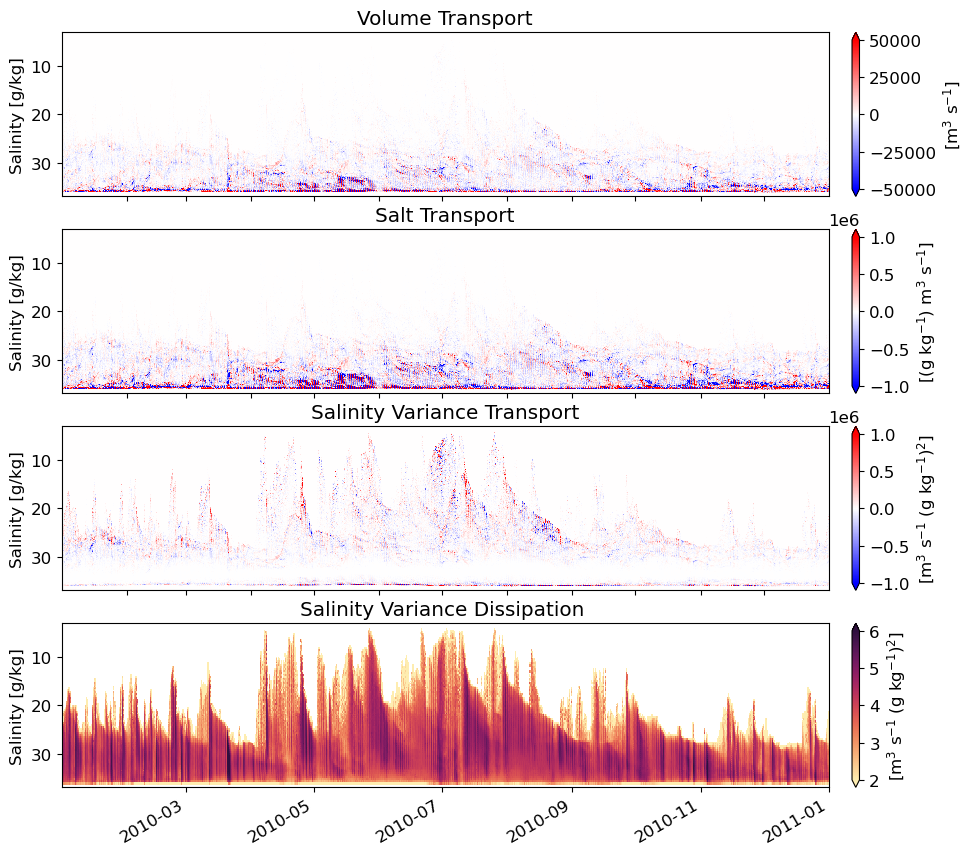

In [284]:
fig, ax = plt.subplots(4,1, figsize = (12,10), dpi = 100)

(tef.Qnet).plot(y = 'salt_bin', 
                cmap = plt.get_cmap('bwr'),
                ax = ax[0],
                cbar_kwargs = {'label': '[m$^3$ s$^{-1}$]',
                               'pad': 0.025},
                vmax = 0.5E5
               )
(tef.Qsnet).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[1],
                    cbar_kwargs = {'label': '[(g kg$^{-1}$) m$^3$ s$^{-1}$]',
                                   'pad': 0.025},
                    vmax = 1e6
                   )
(tef.Qsvarnet).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[2],
                    cbar_kwargs = {'label': '[m$^3$ s$^{-1}$ (g kg$^{-1}$)$^2$]',
                                   'pad': 0.025},
                    vmax = 1e6
                   )

np.log10(chi).plot(y = 'salt_bin', 
                   ax = ax[3],
                    cmap = cmo.matter,
                    cbar_kwargs = {'label': '[m$^3$ s$^{-1}$ (g kg$^{-1}$)$^2$]',
                                   'pad': 0.025},
                    vmin = 2, vmax = 6
                  )

for axs in ax.reshape(-1): 
    axs.set_ylabel('Salinity [g/kg]')
    axs.set_xlabel('')
    axs.set_ylim(3,37)
    
    
ax[0].set_title('Volume Transport')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].invert_yaxis()

ax[1].set_title('Salt Transport')
ax[1].axes.xaxis.set_ticklabels([])
ax[1].invert_yaxis()

ax[2].set_title('Salinity Variance Transport')
ax[2].axes.xaxis.set_ticklabels([])
ax[2].invert_yaxis()

ax[3].set_title(r'Salinity Variance Dissipation ')
ax[3].invert_yaxis()

### Let's attempt to normalize this by plotting dQ^c/ds

In [31]:
salt_bins = np.linspace(0, 40, 501)
ds = salt_bins[1]-salt_bins[0]

In [7]:
dQds = tef.Qnet.diff('salt_bin')/ds
dQsds = tef.Qsnet.diff('salt_bin')/ds
dQsvards = tef.Qsvarnet.diff('salt_bin')/ds

/scratch/user/dylan.schlichting/.conda/envs/romsenv/lib/python3.8/site-packages/xarray/core/computation.py:724: RuntimeWarning: divide by zero encountered in log10
  result_data = func(*input_data)


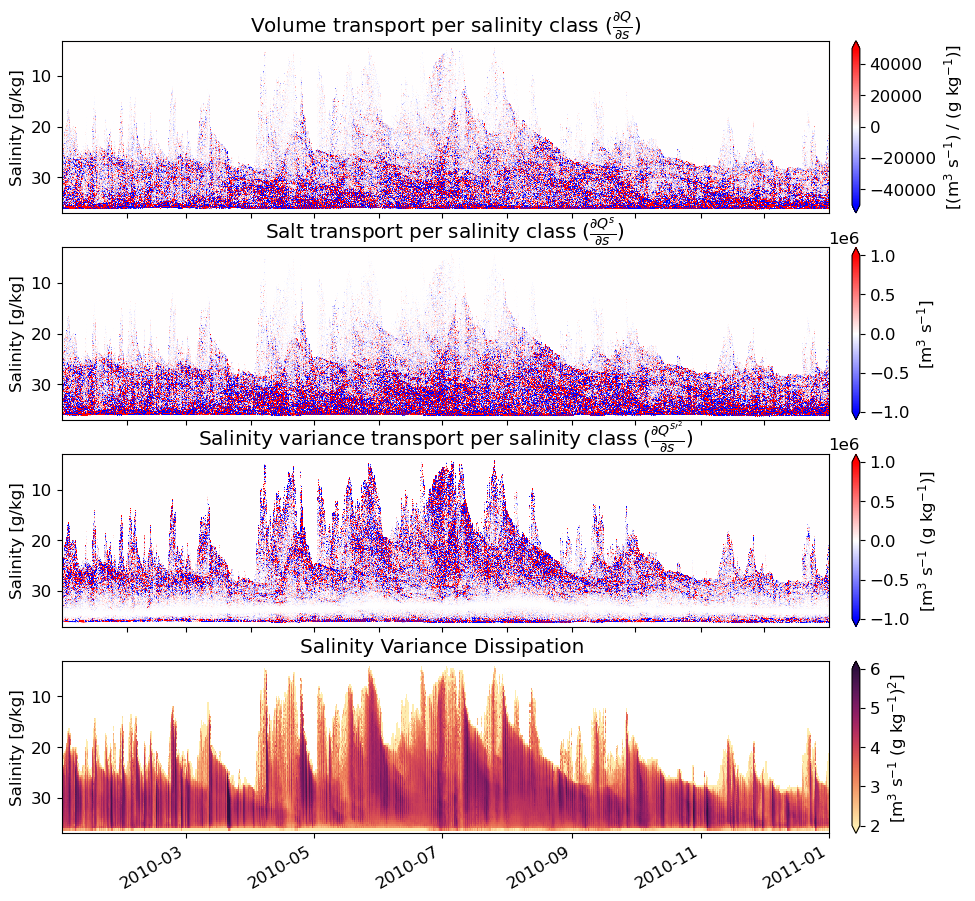

In [8]:
fig, ax = plt.subplots(4,1, figsize = (12,10.5), dpi = 100)

(dQds).plot(y = 'salt_bin', 
                cmap = plt.get_cmap('bwr'),
                ax = ax[0],
                cbar_kwargs = {'label': '[(m$^3$ s$^{-1}$) / (g kg$^{-1}$)]',
                               'pad': 0.025},
                vmax = 0.5E5
               )
(dQsds).plot(y = 'salt_bin', 
                 cmap = plt.get_cmap('bwr'),
                 ax = ax[1],
                 cbar_kwargs = {'label': '[m$^3$ s$^{-1}$]',
                                 'pad': 0.025},
                 vmax = 1e6
                   )
(dQsvards).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[2],
                    cbar_kwargs = {'label': '[m$^3$ s$^{-1}$ (g kg$^{-1}$)]',
                                   'pad': 0.025},
                    vmax = 1e6
                   )

np.log10(chi).plot(y = 'salt_bin', 
                   ax = ax[3],
                    cmap = cmo.matter,
                    cbar_kwargs = {'label': '[m$^3$ s$^{-1}$ (g kg$^{-1}$)$^2$]',
                                   'pad': 0.025},
                    vmin = 2, vmax = 6
                  )

for axs in ax.reshape(-1): 
    axs.set_ylabel('Salinity [g/kg]')
    axs.set_xlabel('')
    axs.set_ylim(3,37)
    
    
ax[0].set_title(r'Volume transport per salinity class ($\frac{\partial Q}{\partial s}$)')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].invert_yaxis()

ax[1].set_title(r'Salt transport per salinity class ($\frac{\partial Q^s}{\partial s}$)')
ax[1].axes.xaxis.set_ticklabels([])
ax[1].invert_yaxis()

ax[2].set_title(r'Salinity variance transport per salinity class ($\frac{\partial Q^{s \prime^2}}{\partial s}$)')
ax[2].axes.xaxis.set_ticklabels([])
ax[2].invert_yaxis()

ax[3].set_title(r'Salinity Variance Dissipation ')
ax[3].invert_yaxis()

### Investigate different normalization schemes. First, try dividing each value by the maximum flux in that particular salinity class.

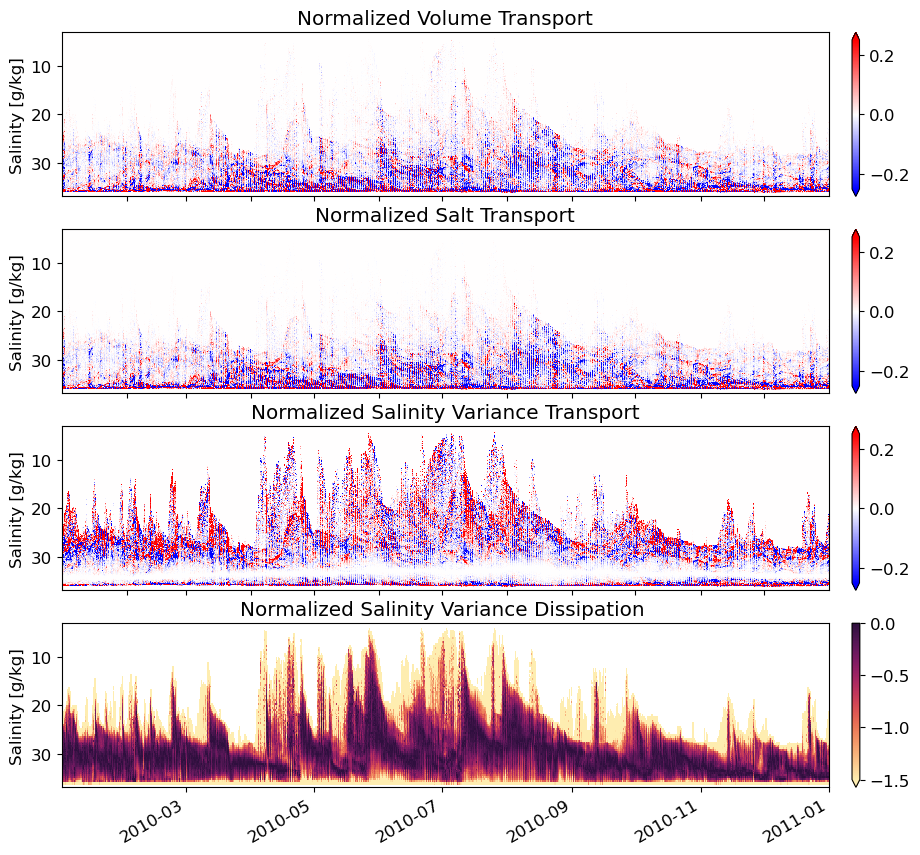

In [291]:
fig, ax = plt.subplots(4,1, figsize = (12,10), dpi = 100)

(tef.Qnet/np.abs(tef.Qnet.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                cmap = plt.get_cmap('bwr'),
                ax = ax[0],
                cbar_kwargs = {'label': '',
                               'pad': 0.025},
                vmin = -.25, vmax = .25
               )
(tef.Qsnet/np.abs(tef.Qsnet.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[1],
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -.25, vmax = .25
                   )
(tef.Qsvarnet/np.abs(tef.Qsvarnet.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[2],
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -.25, vmax = .25
                   )

np.log10(chi/chi.max(dim = 'salt_bin')).plot(y = 'salt_bin', 
                   ax = ax[3],
                    cmap = cmo.matter,
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -1.5, vmax = 0
                  )

for axs in ax.reshape(-1): 
    axs.set_ylabel('Salinity [g/kg]')
    axs.set_xlabel('')
    axs.set_ylim(3,37)
    

ax[0].set_title('Normalized Volume Transport')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].invert_yaxis()

ax[1].set_title('Normalized Salt Transport')
ax[1].axes.xaxis.set_ticklabels([])
ax[1].invert_yaxis()

ax[2].set_title('Normalized Salinity Variance Transport')
ax[2].axes.xaxis.set_ticklabels([])
ax[2].invert_yaxis()

ax[3].set_title(r'Normalized Salinity Variance Dissipation ')
ax[3].invert_yaxis()

(0.0, 50000.0)

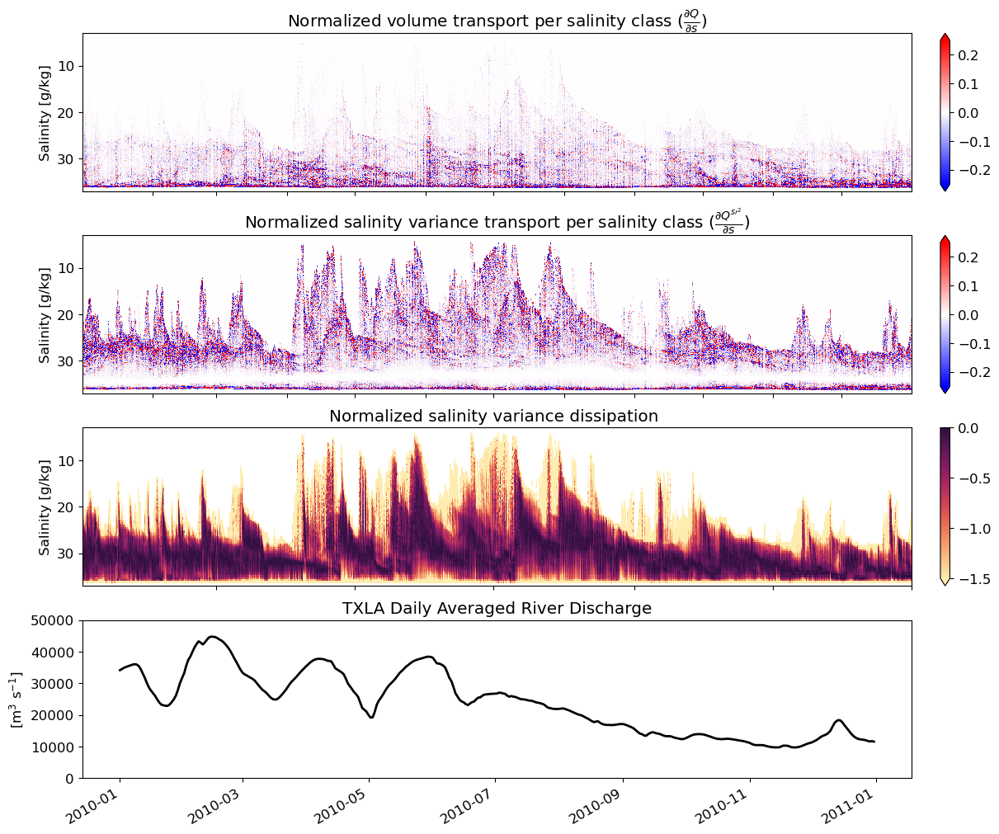

In [293]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig, ax = plt.subplots(4,1, figsize = (12,10), dpi = 100, constrained_layout = True)


(dQds/np.abs(dQds.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                cmap = plt.get_cmap('bwr'),
                ax = ax[0],
                cbar_kwargs = {'label': '',
                               'pad': 0.025},
                vmin = -.25, vmax = .25
               )
(dQsvards/np.abs(dQsvards.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[1],
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -.25, vmax = .25
                   )

np.log10(chi/chi.max(dim = 'salt_bin')).plot(y = 'salt_bin', 
                   ax = ax[2],
                    cmap = cmo.matter,
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -1.5, vmax = 0
                  )

streamflow.plot(ax = ax[3], lw = 2, c = 'k')

for axs in ax.reshape(-1): 
    axs.set_ylabel('Salinity [g/kg]')
    axs.set_xlabel('')
    axs.set_ylim(3,37)
    

ax[0].set_title(r'Normalized volume transport per salinity class ($\frac{\partial Q}{\partial s}$)')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].invert_yaxis()

ax[1].set_title(r'Normalized salinity variance transport per salinity class ($\frac{\partial Q^{s \prime^2}}{\partial s}$)')
ax[1].axes.xaxis.set_ticklabels([])
ax[1].invert_yaxis()


ax[2].set_title(r'Normalized salinity variance dissipation ')
ax[2].invert_yaxis()
ax[2].axes.xaxis.set_ticklabels([])

ax[3].set_title(r'TXLA Daily Averaged River Discharge')
ax[3].set_ylabel(r'[m$^3$ s$^{-1}$]')
ax[3].set_ylim(0, 50000)


In [1]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig, ax = plt.subplots(3,1, figsize = (12,8), dpi = 100, constrained_layout = True)


(tef.Qnet/np.abs(tef.Qnet.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                cmap = plt.get_cmap('bwr'),
                ax = ax[0],
                cbar_kwargs = {'label': '',
                               'pad': 0.025},
                vmin = -.1, vmax = .1
               )
(tef.Qsvarnet/np.abs(tef.Qsvarnet.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[1],
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -.1, vmax = .1
                   )

(chi/chi.max(dim = 'salt_bin')).plot(y = 'salt_bin', 
                   ax = ax[2],
                    cmap = cmo.amp,
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = 0, vmax = 1
                  )

# streamflow.plot(ax = ax[3], lw = 2, c = 'k')

for axs in ax.reshape(-1): 
    axs.set_ylabel('Salinity [g/kg]')
    axs.set_xlabel('')
    axs.set_ylim(3,37)
    

ax[0].set_title(r'Normalized volume transport')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].invert_yaxis()

ax[1].set_title(r'Normalized salinity variance transport')
ax[1].axes.xaxis.set_ticklabels([])
ax[1].invert_yaxis()

ax[2].set_title(r'Normalized salinity variance dissipation')
ax[2].invert_yaxis()
# ax[2].axes.xaxis.set_ticklabels([])

# ax[3].set_title(r'TXLA Daily Averaged River Discharge')
# ax[3].set_ylabel(r'[m$^3$ s$^{-1}$]')
# ax[3].set_ylim(0, 50000)

ax[0].xaxis.set_major_locator(xticks)
ax[1].xaxis.set_major_locator(xticks)
ax[2].xaxis.set_major_locator(xticks)


ax[0].set_xlim('2009-12-31', '2011-01-01')
ax[1].set_xlim('2009-12-31', '2011-01-01')
ax[2].set_xlim('2009-12-31', '2011-01-01')

ax[2].xaxis.set_major_formatter(DateFormatter("%Y/%m"))

NameError: name 'plt' is not defined

### Start looking at the surface fluxes

In [32]:
swflux = surfaceds.swflux.isel(eta_rho = etaslice, xi_rho = xislice,) \
                         .resample(time = '1h').interpolate('linear')[:-1]
 
swflux = swflux.rename({'time':'ocean_time'})

#convert units & slice
ep = ((swflux/100)/86400).load() #cm/d to m/s

dA = ds.dA.isel(eta_rho = etaslice, xi_rho = xislice,)

epda = (ep*dA).sum(['eta_rho','xi_rho'])

AttributeError: 'numpy.float64' object has no attribute 'dA'

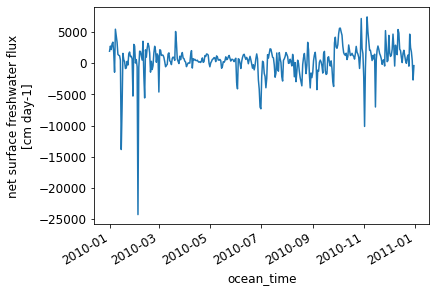

In [19]:
ep_daily = epda.resample(ocean_time = 'D').mean()
ep_daily.plot()

NameError: name 'ep_daily' is not defined

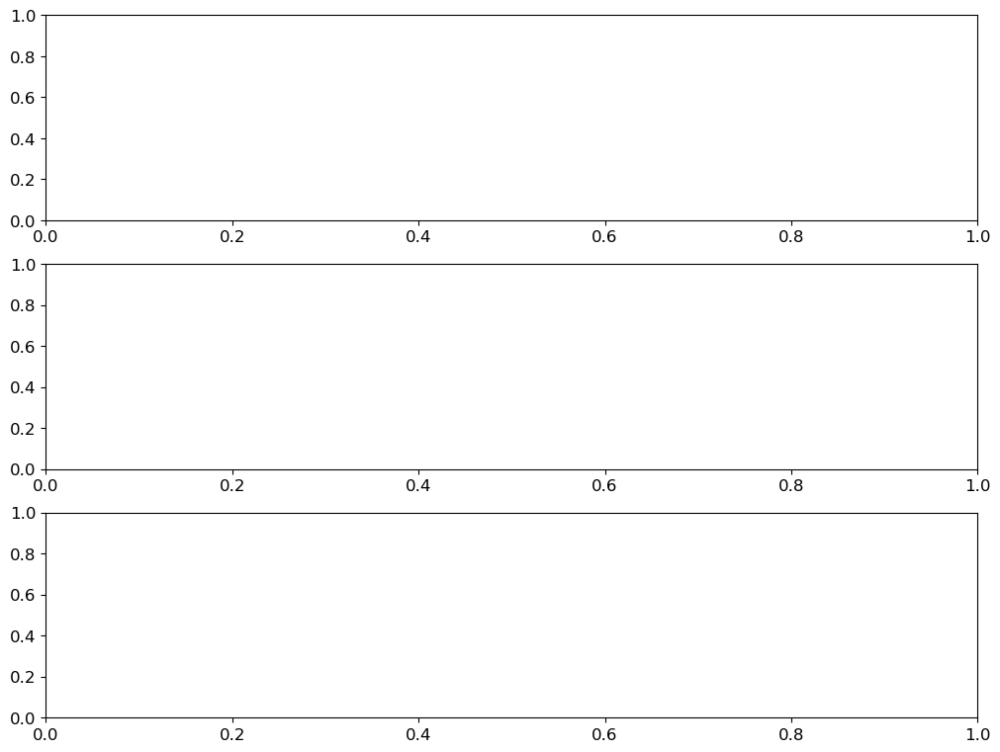

In [16]:
from matplotlib import ticker
from matplotlib.dates import DateFormatter

fig, ax = plt.subplots(3,1, figsize = (10,7.5), dpi = 100, constrained_layout = True)

ep_daily.sel(ocean_time = slice('2010-01-01 01:00', '2010-12-31 23:00')).plot(ax = ax[0], lw = 2, c = 'k')
streamflow.sel(river_time = slice('2010-01-01 01:00', '2010-12-31 23:00')).plot(ax = ax[1], lw = 2, c = 'k')
    
ax[0].set_title(r'TXLA daily averaged surface freshwater fluxes')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].set_ylabel(r'[m$^3$ s$^{-1}$]')
ax[0].invert_yaxis()
ax[0].set_xlabel('')

ax[1].set_title(r'TXLA daily averaged river discharge')
ax[1].set_ylabel(r'[m$^3$ s$^{-1}$]')
ax[1].set_ylim(0, 50000)
ax[1].set_xlabel('')
ax[1].axes.xaxis.set_ticklabels([])

(tef.Qsvarnet/np.abs(tef.Qsvarnet.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                     cmap = plt.get_cmap('bwr'),
                     ax = ax[2],
                     cbar_kwargs = {'label': '',
                                    'pad': 0.025},
                     vmin = -1, vmax = 1
                   )

ax[2].set_ylabel('Salinity [g/kg]')
ax[2].set_ylim(3,37)
ax[2].set_title(r'Normalized salinity variance transport')
ax[2].invert_yaxis()
ax[2].set_xlabel('')

M = 13
xticks = ticker.MaxNLocator(M)

# Set the yaxis major locator using your ticker object. You can also choose the minor
# tick positions with set_minor_locator.
ax[0].xaxis.set_major_locator(xticks)
ax[1].xaxis.set_major_locator(xticks)
ax[2].xaxis.set_major_locator(xticks)

ax[0].set_xlim('2009-12-31', '2011-01-01')
ax[1].set_xlim('2009-12-31', '2011-01-01')
ax[2].set_xlim('2009-12-31', '2011-01-01')

ax[2].xaxis.set_major_formatter(DateFormatter("%Y/%m"))

In [21]:
uwind = xroms.to_rho(surfaceds.Uwind, grid).isel(eta_rho = etaslice, xi_rho = xislice) \
                         .resample(time = '1h').interpolate('linear')[:-1]
vwind = xroms.to_rho(surfaceds.Vwind, grid).isel(eta_rho = etaslice, xi_rho = xislice) \
                         .resample(time = '1h').interpolate('linear')[:-1]

stresstot = xr.ufuncs.sqrt(uwind**2+vwind**2).mean(['eta_rho', 'xi_rho']).load()

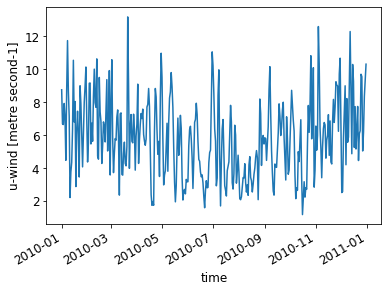

In [22]:
stressd = stresstot.resample(time = 'D').mean()
stressd.plot()

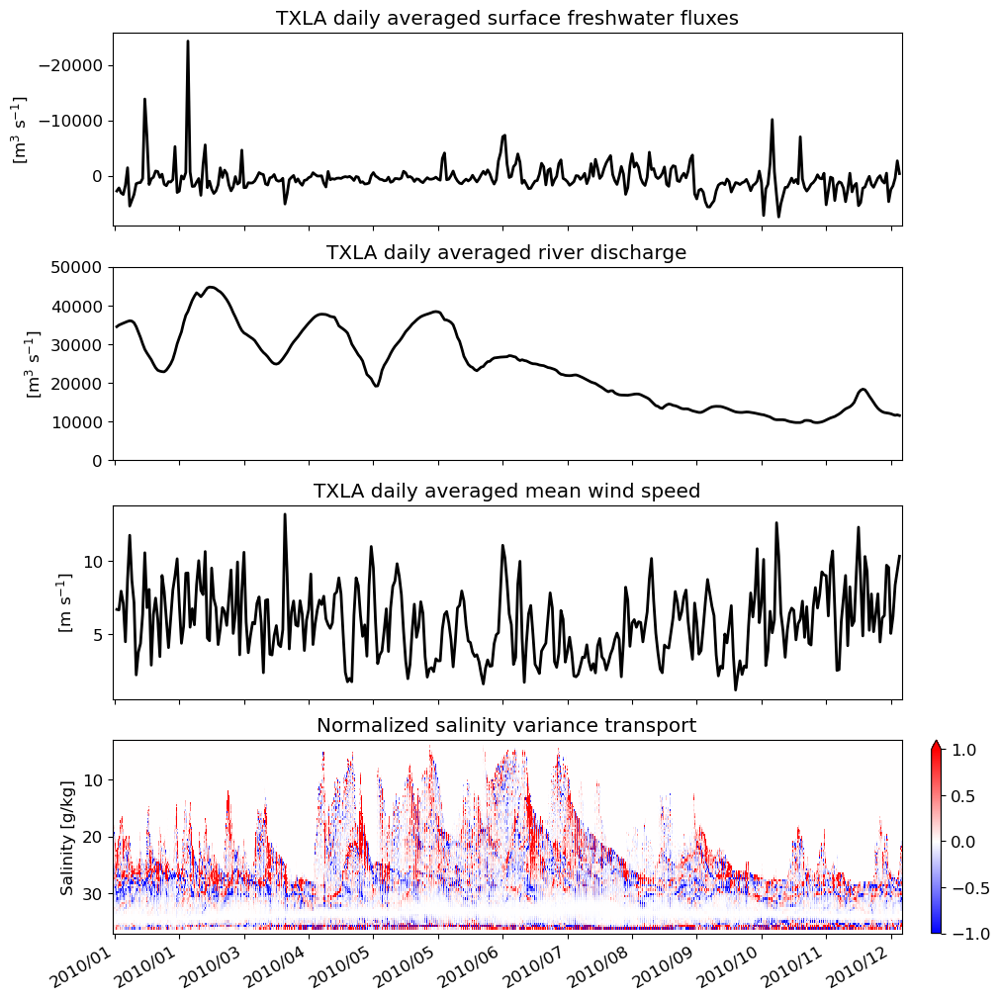

In [272]:
from matplotlib import ticker
from matplotlib.dates import DateFormatter

fig, ax = plt.subplots(4,1, figsize = (10,10), dpi = 100, constrained_layout = True)

ep_daily.sel(ocean_time = slice('2010-06', '2010-08')).plot(ax = ax[0], lw = 2, c = 'k')
streamflow.sel(river_time = slice('2010-06', '2010-08')).plot(ax = ax[1], lw = 2, c = 'k')
    
ax[0].set_title(r'TXLA daily averaged surface freshwater fluxes')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].set_ylabel(r'[m$^3$ s$^{-1}$]')
ax[0].invert_yaxis()
ax[0].set_xlabel('')

ax[1].set_title(r'TXLA daily averaged river discharge')
ax[1].set_ylabel(r'[m$^3$ s$^{-1}$]')
ax[1].set_ylim(0, 50000)
ax[1].set_xlabel('')
ax[1].axes.xaxis.set_ticklabels([])

stressd.sel(time = slice('2010-01-01 01:00', '2010-12-31 23:00')).plot(ax = ax[2], lw = 2, c = 'k')

(tef.Qsvarnet/np.abs(tef.Qsvarnet.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                     cmap = plt.get_cmap('bwr'),
                     ax = ax[3],
                     cbar_kwargs = {'label': '',
                                    'pad': 0.025},
                     vmin = -1, vmax = 1
                   )

ax[2].set_title('TXLA daily averaged mean wind speed')
ax[2].set_ylabel('[m s$^{-1}$]')
ax[2].set_xlabel('')
ax[2].axes.xaxis.set_ticklabels([])

ax[3].set_ylabel('Salinity [g/kg]')
ax[3].set_ylim(3,37)
ax[3].set_title(r'Normalized salinity variance transport')
ax[3].invert_yaxis()

M = 13
xticks = ticker.MaxNLocator(M)

# Set the yaxis major locator using your ticker object. You can also choose the minor
# tick positions with set_minor_locator.
ax[0].xaxis.set_major_locator(xticks)
ax[1].xaxis.set_major_locator(xticks)
ax[2].xaxis.set_major_locator(xticks)
ax[3].xaxis.set_major_locator(xticks)
ax[3].set_xlabel('')

ax[0].set_xlim('2010--31', '2011-01-01')
ax[1].set_xlim('2009-12-31', '2011-01-01')
ax[2].set_xlim('2009-12-31', '2011-01-01')
ax[3].set_xlim('2009-12-31', '2011-01-01')

ax[3].xaxis.set_major_formatter(DateFormatter("%Y/%m"))

/scratch/user/dylan.schlichting/.conda/envs/romsenv/lib/python3.8/site-packages/xarray/core/computation.py:724: RuntimeWarning: divide by zero encountered in log10
  result_data = func(*input_data)


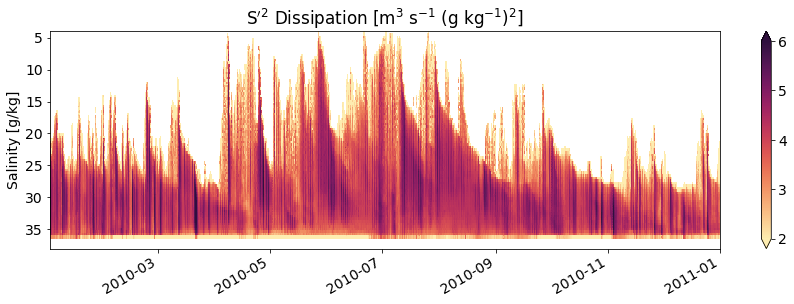

In [22]:
fig, ax = plt.subplots(1, figsize = (15,4))

np.log10(chi).plot(y = 'salt_bin', 
                    cmap = cmo.matter,
                    cbar_kwargs = {'label': ''},
                    vmin = 2, vmax = 6
             )

ax.set_xlabel('')
ax.set_ylabel('Salinity [g/kg]')
ax.set_ylim(4,38)
ax.set_title(r'S$^\prime{^2}$ Dissipation [m$^3$ s$^{-1}$ (g kg$^{-1}$)$^2$]')
ax.invert_yaxis()

Text(0.5, 1.0, 'Daily Averaged TXLA River Discharge')

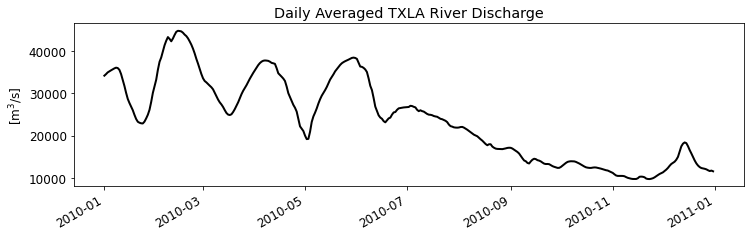

In [119]:
fig, ax = plt.subplots(1, figsize = (12,3))
streamflow.plot(lw = 2, c = 'k')
plt.xlabel('')
plt.ylabel('[m$^3$/s]')
plt.title('Daily Averaged TXLA River Discharge')

In [ ]:
chidaily = chi.sum('salt_bin').resample(ocean_time = 'D').mean().sel(ocean_time = '2010')

In [ ]:
dVdt_da = storage.dVdt.resample(ocean_time = 'D').mean()
storage = storage.assign(dVdt_da = storage.dVdt.resample(ocean_time = 'D').mean())

In [ ]:
dVdt_da.plot()

In [ ]:
storage.dVdt_da.plot()

## Look at seasonal differences. Start with summer 

/scratch/user/dylan.schlichting/.conda/envs/romsenv/lib/python3.8/site-packages/xarray/core/computation.py:724: RuntimeWarning: divide by zero encountered in log10
  result_data = func(*input_data)


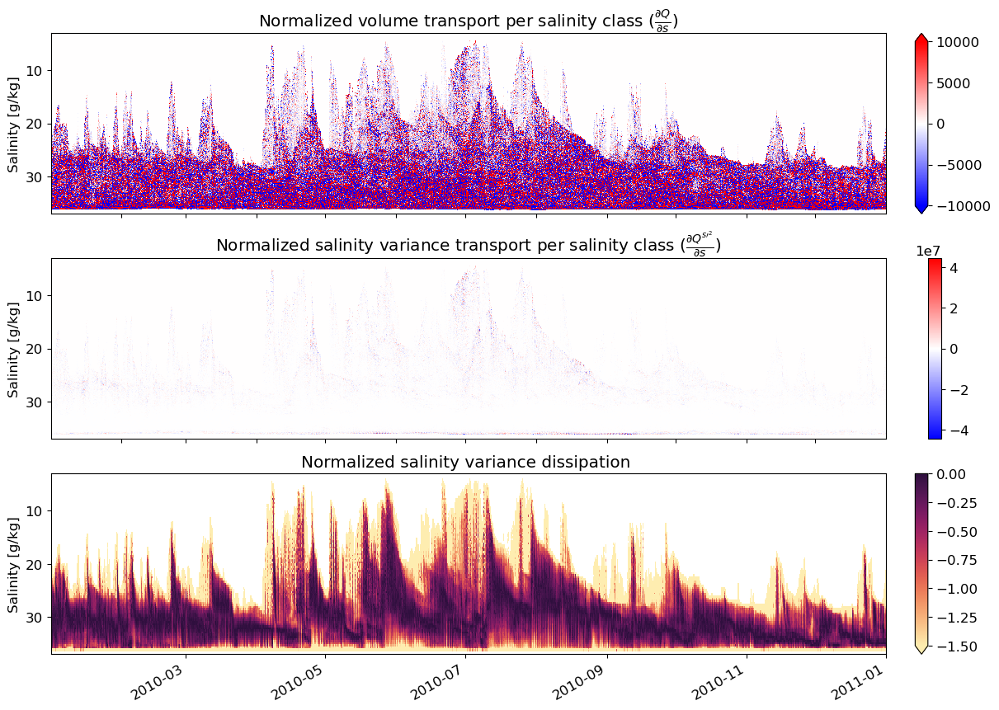

In [41]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig, ax = plt.subplots(3,1, figsize = (12,8.5), dpi = 100, constrained_layout = True)


(dQds).plot(y = 'salt_bin', 
                cmap = plt.get_cmap('bwr'),
                ax = ax[0],
                cbar_kwargs = {'label': '',
                               'pad': 0.025},
                vmax = 1e4
               )
(dQsvards).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[1],
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    
                   )

np.log10(chi/chi.max(dim = 'salt_bin')).plot(y = 'salt_bin', 
                   ax = ax[2],
                    cmap = cmo.matter,
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -1.5, vmax = 0
                  )
for axs in ax.reshape(-1): 
    axs.set_ylabel('Salinity [g/kg]')
    axs.set_xlabel('')
    axs.set_ylim(3,37)
    

ax[0].set_title(r'Normalized volume transport per salinity class ($\frac{\partial Q}{\partial s}$)')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].invert_yaxis()

ax[1].set_title(r'Normalized salinity variance transport per salinity class ($\frac{\partial Q^{s \prime^2}}{\partial s}$)')
ax[1].axes.xaxis.set_ticklabels([])
ax[1].invert_yaxis()


ax[2].set_title(r'Normalized salinity variance dissipation ')
ax[2].invert_yaxis()
# ax[2].axes.xaxis.set_ticklabels([])

/scratch/user/dylan.schlichting/.conda/envs/romsenv/lib/python3.8/site-packages/xarray/core/computation.py:724: RuntimeWarning: divide by zero encountered in log10
  result_data = func(*input_data)


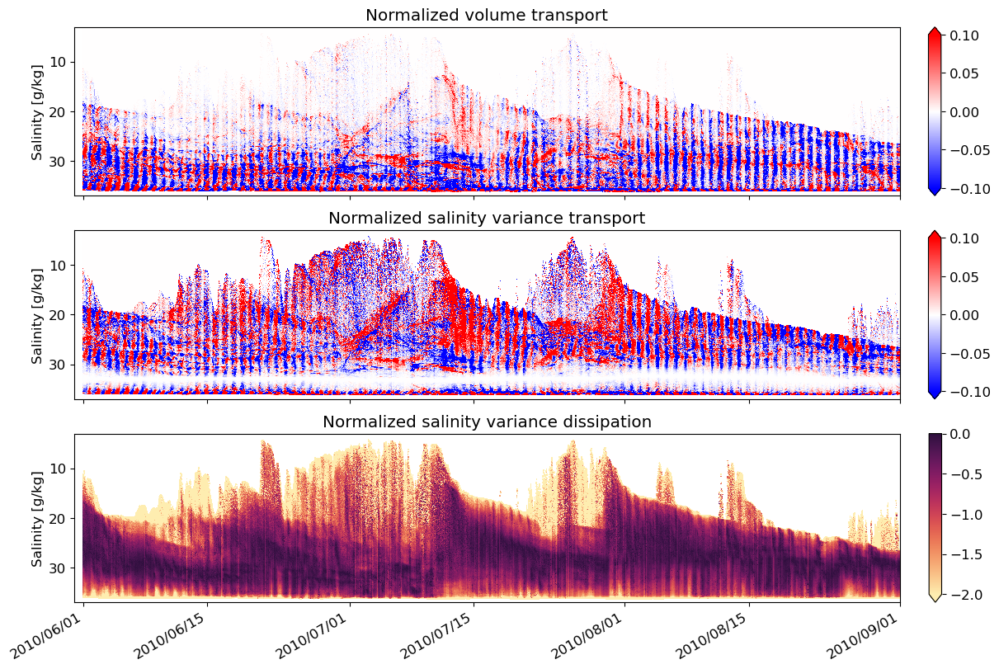

In [15]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig, ax = plt.subplots(3,1, figsize = (12,8), dpi = 100, constrained_layout = True)


(tef.Qnet.sel(ocean_time = slice('2010-06', '2010-08'))/np.abs(tef.Qnet.sel(ocean_time = slice('2010-06', '2010-08')).min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                cmap = plt.get_cmap('bwr'),
                ax = ax[0],
                cbar_kwargs = {'label': '',
                               'pad': 0.025},
                vmin = -.1, vmax = .1
               )
(tef.Qsvarnet.sel(ocean_time = slice('2010-06', '2010-08'))/np.abs(tef.Qsvarnet.sel(ocean_time = slice('2010-06', '2010-08')).min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[1],
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -.1, vmax = .1
                   )

np.log10(chi.sel(ocean_time = slice('2010-06', '2010-08'))/chi.sel(ocean_time = slice('2010-06', '2010-08')).max(dim = 'salt_bin')).plot(y = 'salt_bin', 
                   ax = ax[2],
                    cmap = cmo.matter,
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -2, vmax = 0
                  )

for axs in ax.reshape(-1): 
    axs.set_ylabel('Salinity [g/kg]')
    axs.set_xlabel('')
    axs.set_ylim(3,37)
    

ax[0].set_title(r'Normalized volume transport')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].invert_yaxis()

ax[1].set_title(r'Normalized salinity variance transport')
ax[1].axes.xaxis.set_ticklabels([])

ax[1].invert_yaxis()

ax[2].set_title(r'Normalized salinity variance dissipation')
ax[2].invert_yaxis()

# M = 10
# xticks = ticker.MaxNLocator(M)

# ax[0].xaxis.set_major_locator(xticks)
# ax[1].xaxis.set_major_locator(xticks)
# ax[2].xaxis.set_major_locator(xticks)
ax[2].set_xlabel('')

ax[0].set_xlim('2010-05-31', '2010-09-01')
ax[1].set_xlim('2010-05-31', '2010-09-01')
ax[2].set_xlim('2010-05-31', '2010-09-01')

ax[2].xaxis.set_major_formatter(DateFormatter("%Y/%m/%d"))

In [48]:
from matplotlib import ticker
from matplotlib.dates import DateFormatter

fig, ax = plt.subplots(4,1, figsize = (10,10), dpi = 100, constrained_layout = True)

ep_daily.sel(ocean_time = slice('2010-01-01 01:00', '2010-12-31 23:00')).plot(ax = ax[0], lw = 2, c = 'k')
streamflow.sel(river_time = slice('2010-01-01 01:00', '2010-12-31 23:00')).plot(ax = ax[1], lw = 2, c = 'k')
    
ax[0].set_title(r'TXLA daily averaged surface freshwater fluxes')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].set_ylabel(r'[m$^3$ s$^{-1}$]')
ax[0].invert_yaxis()
ax[0].set_xlabel('')

ax[1].set_title(r'TXLA daily averaged river discharge')
ax[1].set_ylabel(r'[m$^3$ s$^{-1}$]')
ax[1].set_ylim(0, 50000)
ax[1].set_xlabel('')
ax[1].axes.xaxis.set_ticklabels([])

stressd.sel(time = slice('2010-01-01 01:00', '2010-12-31 23:00')).plot(ax = ax[2], lw = 2, c = 'k')

(tef.Qsvarnet/np.abs(tef.Qsvarnet.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                     cmap = plt.get_cmap('bwr'),
                     ax = ax[3],
                     cbar_kwargs = {'label': '',
                                    'pad': 0.025},
                     vmin = -1, vmax = 1
                   )

ax[2].set_title('TXLA daily averaged mean wind speed')
ax[2].set_ylabel('[m s$^{-1}$]')
ax[2].set_xlabel('')
ax[2].axes.xaxis.set_ticklabels([])

ax[3].set_ylabel('Salinity [g/kg]')
ax[3].set_ylim(3,37)
ax[3].set_title(r'Normalized salinity variance transport')
ax[3].invert_yaxis()

M = 13
xticks = ticker.MaxNLocator(M)

# Set the yaxis major locator using your ticker object. You can also choose the minor
# tick positions with set_minor_locator.
ax[0].xaxis.set_major_locator(xticks)
ax[1].xaxis.set_major_locator(xticks)
ax[2].xaxis.set_major_locator(xticks)
ax[3].xaxis.set_major_locator(xticks)
ax[3].set_xlabel('')

ax[0].set_xlim('2009-12-31', '2011-01-01')
ax[1].set_xlim('2009-12-31', '2011-01-01')
ax[2].set_xlim('2009-12-31', '2011-01-01')
ax[3].set_xlim('2009-12-31', '2011-01-01')

ax[3].xaxis.set_major_formatter(DateFormatter("%Y/%m"))

<xarray.DataArray 'chi' (ocean_time: 8760, salt_bin: 500)>
[4380000 values with dtype=float64]
Coordinates:
  * ocean_time  (ocean_time) datetime64[ns] 2010-01-01T01:00:00 ... 2011-01-01
  * salt_bin    (salt_bin) float64 0.04 0.12 0.2 0.28 ... 39.72 39.8 39.88 39.96

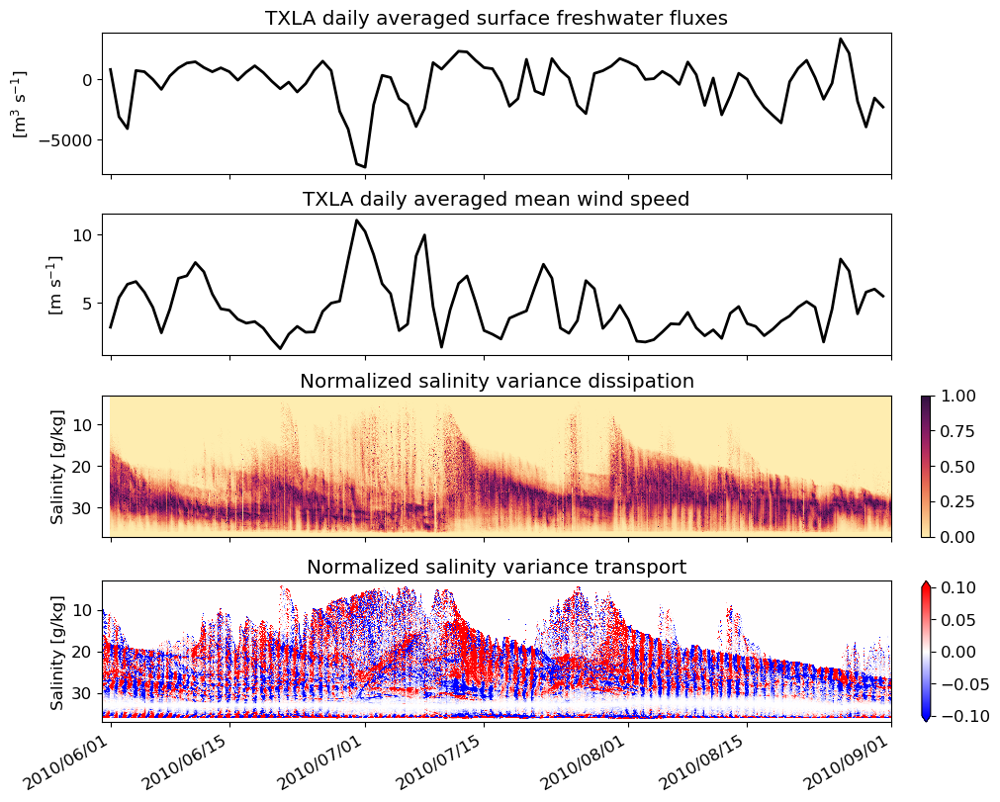

In [33]:
from matplotlib import ticker
from matplotlib.dates import DateFormatter

fig, ax = plt.subplots(4,1, figsize = (10,8), dpi = 100, constrained_layout = True)

ep_daily.sel(ocean_time = slice('2010-06', '2010-08')).plot(ax = ax[0], lw = 2, c = 'k')

ax[0].set_title(r'TXLA daily averaged surface freshwater fluxes')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].set_ylabel(r'[m$^3$ s$^{-1}$]')
ax[0].set_xlabel('')

stressd.sel(time = slice('2010-06', '2010-08')).plot(ax = ax[1], lw = 2, c = 'k')

ax[1].set_title('TXLA daily averaged mean wind speed')
ax[1].set_ylabel('[m s$^{-1}$]')
ax[1].set_xlabel('')
ax[1].axes.xaxis.set_ticklabels([])

(chi.sel(ocean_time = slice('2010-06', '2010-08'))/chi.sel(ocean_time = slice('2010-06', '2010-08')).max(dim = 'salt_bin')).plot(y = 'salt_bin', 
                   ax = ax[2],
                    cmap = cmo.matter,
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = 0, vmax = 1
                  )

ax[2].set_title(r'Normalized salinity variance dissipation')
ax[2].set_ylabel('Salinity [g/kg]')
ax[2].set_ylim(3,37)
ax[2].invert_yaxis()
ax[2].axes.xaxis.set_ticklabels([])
ax[2].set_xlabel('')

(tef.Qsvarnet/np.abs(tef.Qsvarnet.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                     cmap = plt.get_cmap('bwr'),
                     ax = ax[3],
                     cbar_kwargs = {'label': '',
                                    'pad': 0.025},
                     vmin = -.1, vmax = .1
                   )



ax[3].set_ylabel('Salinity [g/kg]')
ax[3].set_ylim(3,37)
ax[3].set_title(r'Normalized salinity variance transport')
ax[3].invert_yaxis()

# M = 7
# xticks = ticker.MaxNLocator(M)

# Set the yaxis major locator using your ticker object. You can also choose the minor
# tick positions with set_minor_locator.
# ax[0].xaxis.set_major_locator(xticks)
# ax[1].xaxis.set_major_locator(xticks)
# ax[2].xaxis.set_major_locator(xticks)
# ax[3].xaxis.set_major_locator(xticks)
ax[3].set_xlabel('')

ax[0].set_xlim('2010-05-31', '2010-09-01')
ax[1].set_xlim('2010-05-31', '2010-09-01')
ax[2].set_xlim('2010-05-31', '2010-09-01')
ax[3].set_xlim('2010-05-31', '2010-09-01')

ax[3].xaxis.set_major_formatter(DateFormatter("%Y/%m/%d"))

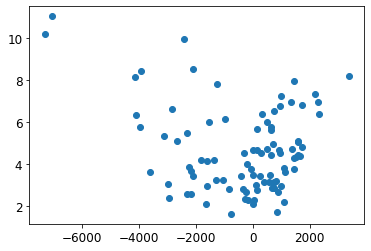

In [34]:
plt.scatter(ep_daily.sel(ocean_time = slice('2010-06', '2010-08')), stressd.sel(time = slice('2010-06', '2010-08')))

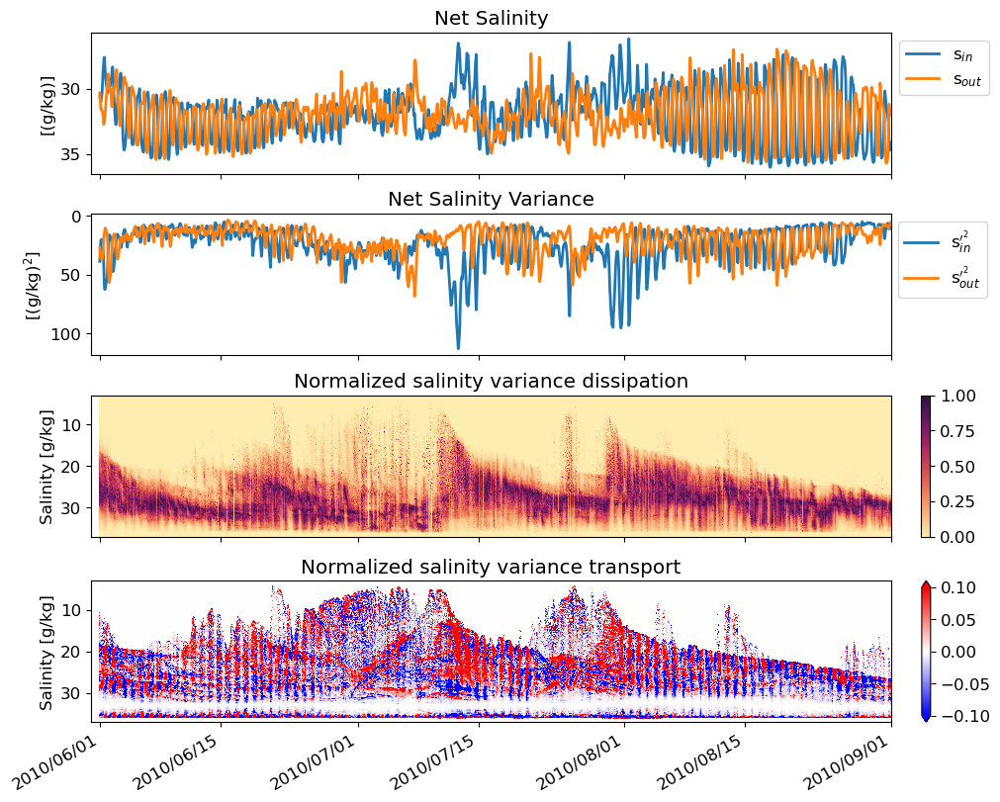

In [84]:
fig, ax = plt.subplots(4, figsize = (10,8), dpi = 100, constrained_layout = True)

tef.sin.sel(ocean_time = slice('2010-06', '2010-08')).plot(lw = 2, ax = ax[0], label = 's$_{in}$')
tef.sout.sel(ocean_time = slice('2010-06', '2010-08')).plot(lw = 2, ax = ax[0], label = 's$_{out}$')

ax[0].set_xlabel('')
ax[0].set_ylabel(r'[(g/kg)]')
ax[0].set_title('Net Salinity')
ax[0].axes.xaxis.set_ticklabels([])

tef.svarin.sel(ocean_time = slice('2010-06', '2010-08')).plot(lw = 2, ax = ax[1], label = 's$_{in}^{\prime^2}$')
tef.svarout.sel(ocean_time = slice('2010-06', '2010-08')).plot(lw = 2, ax = ax[1], label = 's$_{out}^{\prime^2}$')

ax[1].set_title('Net Salinity Variance')
ax[1].set_ylabel(r'[(g/kg)$^2$]')
ax[1].set_xlabel('')
ax[0].legend(bbox_to_anchor=(1.0, 1.00))
ax[1].legend(bbox_to_anchor=(1.13, 1.00))
ax[0].invert_yaxis()
ax[1].invert_yaxis()
ax[1].axes.xaxis.set_ticklabels([])

(chi.sel(ocean_time = slice('2010-06', '2010-08'))/chi.sel(ocean_time = slice('2010-06', '2010-08')).max(dim = 'salt_bin')).plot(y = 'salt_bin', 
                   ax = ax[2],
                    cmap = cmo.matter,
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = 0, vmax = 1
                  )

ax[2].set_title(r'Normalized salinity variance dissipation')
ax[2].set_ylabel('Salinity [g/kg]')
ax[2].set_ylim(3,37)
ax[2].invert_yaxis()
ax[2].axes.xaxis.set_ticklabels([])
ax[2].set_xlabel('')

test = ((tef.Qsvarnet/np.abs(tef.Qsvarnet.min(dim = 'salt_bin'))).sel(ocean_time = slice('2010-06', '2010-08')))
test.plot(y = 'salt_bin', 
                     cmap = plt.get_cmap('bwr'),
                     ax = ax[3],
                     cbar_kwargs = {'label': '',
                                    'pad': 0.025},
                     vmin = -.1, 
                     vmax = .1)


ax[3].set_ylabel('Salinity [g/kg]')
ax[3].set_ylim(3,37)
ax[3].set_title(r'Normalized salinity variance transport')
ax[3].invert_yaxis()
ax[3].set_xlabel('')

ax[0].set_xlim('2010-05-31', '2010-09-01')
ax[1].set_xlim('2010-05-31', '2010-09-01')
ax[2].set_xlim('2010-05-31', '2010-09-01')
ax[3].set_xlim('2010-05-31', '2010-09-01')

ax[3].xaxis.set_major_formatter(DateFormatter("%Y/%m/%d"))

In [76]:
test = ((tef.Qsvarnet/np.abs(tef.Qsvarnet.min(dim = 'salt_bin'))).sel(ocean_time = slice('2010-06', '2010-08')))
test.plot(y = 'salt_bin', 
                     cmap = plt.get_cmap('bwr'),
                     ax = ax[3],
                     cbar_kwargs = {'label': '',
                                    'pad': 0.025},
                     vmin = -.1, 
                     vmax = .1)

## Remove the inertial signal from the tracer fluxes. Start with a simple rolling mean

In [14]:
volw = tef.Qnet.sel(ocean_time = slice('2010-06', '2010-08')).rolling(ocean_time = 25*1, center = True).mean()
Qsvarw = tef.Qsvarnet.sel(ocean_time = slice('2010-06', '2010-08')).rolling(ocean_time = 25*1, center = True).mean()
chiw = chi.sel(ocean_time = slice('2010-06', '2010-08')).rolling(ocean_time = 25*1, center = True).mean()

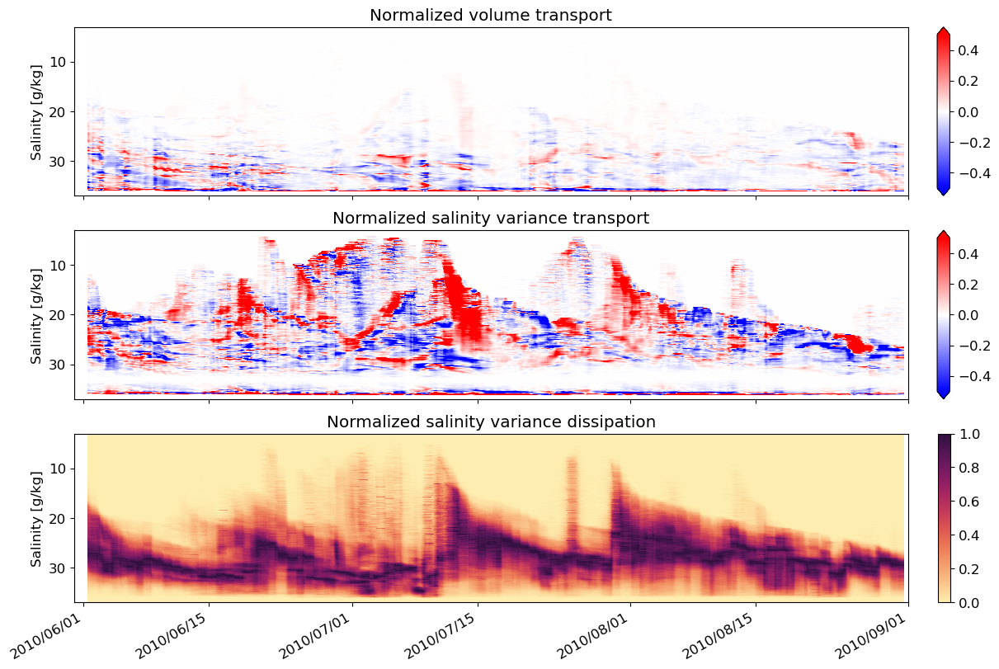

In [15]:
fig, ax = plt.subplots(3,1, figsize = (12,8), dpi = 100, constrained_layout = True)

(volw/(np.abs(volw).max(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                                                cmap = plt.get_cmap('bwr'),
                                                ax = ax[0],
                                                cbar_kwargs = {'label': '',
                                               'pad': 0.025},
                                                vmin = -.5, vmax = .5
               )
(Qsvarw/np.abs(Qsvarw.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[1],
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -.5, vmax = .5
                   )

(chiw/(chiw.max(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                   ax = ax[2],
                    cmap = cmo.matter,
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = 0, vmax = 1
                  )

for axs in ax.reshape(-1): 
    axs.set_ylabel('Salinity [g/kg]')
    axs.set_xlabel('')
    axs.set_ylim(3,37)
    
ax[0].set_title(r'Normalized volume transport')
ax[0].axes.xaxis.set_ticklabels([])
ax[0].invert_yaxis()

ax[1].set_title(r'Normalized salinity variance transport')
ax[1].axes.xaxis.set_ticklabels([])
ax[1].invert_yaxis()

ax[2].set_title(r'Normalized salinity variance dissipation')
ax[2].invert_yaxis()
ax[2].set_xlabel('')

ax[0].set_xlim('2010-05-31', '2010-09-01')
ax[1].set_xlim('2010-05-31', '2010-09-01')
ax[2].set_xlim('2010-05-31', '2010-09-01')

ax[2].xaxis.set_major_formatter(DateFormatter("%Y/%m/%d"))

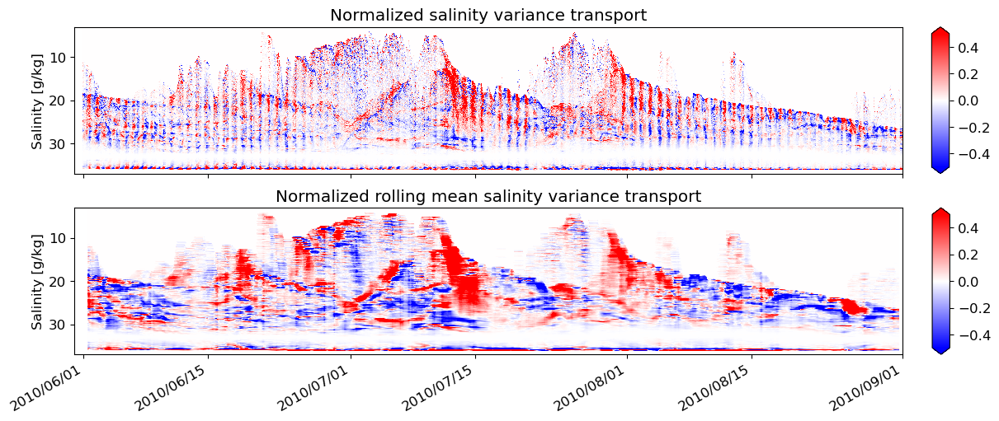

In [104]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig, ax = plt.subplots(2,1, figsize = (12,5), dpi = 100, constrained_layout = True)

test = ((tef.Qsvarnet/np.abs(tef.Qsvarnet.min(dim = 'salt_bin'))).sel(ocean_time = slice('2010-06', '2010-08')))
test.plot(y = 'salt_bin', 
                     cmap = plt.get_cmap('bwr'),
                     ax = ax[0],
                     cbar_kwargs = {'label': '',
                                    'pad': 0.025},
                     vmin = -.5, 
                     vmax = .5)

(Qsvarw/np.abs(Qsvarw.min(dim = 'salt_bin'))).plot(y = 'salt_bin', 
                    cmap = plt.get_cmap('bwr'),
                    ax = ax[1],
                    cbar_kwargs = {'label': '',
                                   'pad': 0.025},
                    vmin = -.5, vmax = .5
                   )

for axs in ax.reshape(-1): 
    axs.set_ylabel('Salinity [g/kg]')
    axs.set_xlabel('')
    axs.set_ylim(3,37)
    

ax[0].set_title(r'Normalized salinity variance transport')
ax[0].axes.xaxis.set_ticklabels([])

ax[1].set_title(r'Normalized rolling mean salinity variance transport')

ax[0].invert_yaxis()
ax[1].invert_yaxis()

# M = 10
# xticks = ticker.MaxNLocator(M)

# ax[0].xaxis.set_major_locator(xticks)
# ax[1].xaxis.set_major_locator(xticks)
# ax[2].xaxis.set_major_locator(xticks)
ax[1].set_xlabel('')

ax[0].set_xlim('2010-05-31', '2010-09-01')
ax[1].set_xlim('2010-05-31', '2010-09-01')

ax[1].xaxis.set_major_formatter(DateFormatter("%Y/%m/%d"))

In [68]:
volslice = tef.Qnet.sel(ocean_time = slice('2010-06', '2010-08'))
Qsvarslice = tef.Qsvarnet.sel(ocean_time = slice('2010-06', '2010-08'))
chislice = chi.sel(ocean_time = slice('2010-06', '2010-08'))

Text(0.5, 0, '')

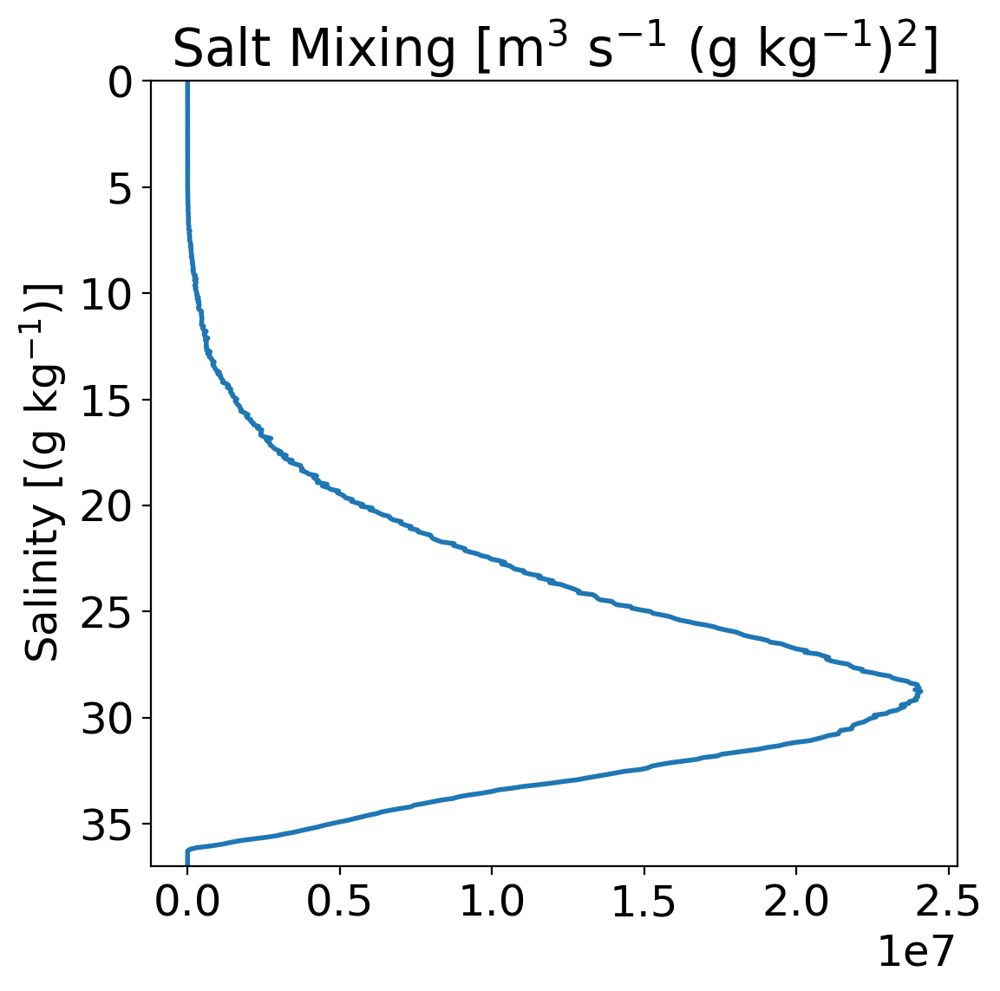

In [109]:
fig, ax = plt.subplots(1, figsize = (6,6), dpi = 200)

chislice.sum('ocean_time').plot(y = 'salt_bin', lw = 2, label = 'Resolved Mixing')
# resmix.plot(y = 'salt_bin', lw = 2, label = 'Total Mixing')

plt.ylim(0,37)
ax.invert_yaxis()
plt.title('Salt Mixing [m$^3$ s$^{-1}$ (g kg$^{-1}$)$^2$]')
plt.ylabel('Salinity [(g kg$^{-1}$)]')
plt.xlabel('')
# plt.legend()

In [17]:


volw = volslice.rolling(ocean_time = 25*1, center = True).mean()
Qsvarw = Qsvarslice.rolling(ocean_time = 25*1, center = True).mean()
chiw = chislice.rolling(ocean_time = 25*1, center = True).mean()

Text(0.5, 1.0, 'Normalized Salt Variance Dissipation')

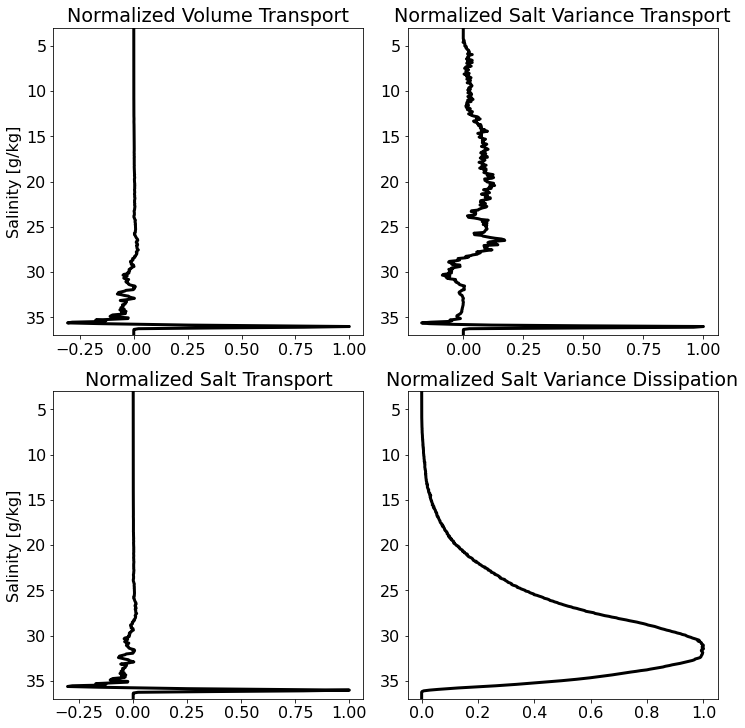

In [57]:
plt.rcParams.update({'font.size': 16})

fig, ax = plt.subplots(2,2 ,figsize = (10,10), constrained_layout = True)


Qnorm = (tef.Qnet.sum('ocean_time')/(tef.Qnet.sum('ocean_time').max()))
Qnorm.plot(ax = ax[0,0], 
           y = 'salt_bin', 
           ylim = (3,37),
           c = 'k',
           lw = 3)

ax[0,0].invert_yaxis()
ax[0,0].set_xlabel('')
ax[0,0].set_title('Normalized Volume Transport')
ax[0,0].set_ylabel('Salinity [g/kg]')

Qsnorm = (tef.Qsnet.sum('ocean_time')/(tef.Qsnet.sum('ocean_time').max()))
Qsnorm.plot(ax = ax[1,0], 
            y = 'salt_bin', 
            ylim = (3,37),
            c = 'k',
            lw = 3)

ax[1,0].invert_yaxis()
ax[1,0].set_xlabel('')
ax[1,0].set_title('Normalized Salt Transport')
ax[1,0].set_ylabel('Salinity [g/kg]')

Qsvarnorm = (tef.Qsvarnet.sum('ocean_time')/(tef.Qsvarnet.sum('ocean_time').max()))
Qsvarnorm.plot(ax = ax[0,1], 
               y = 'salt_bin', 
               ylim = (3,37),
               c = 'k',
               lw = 3)

ax[0,1].invert_yaxis()
ax[0,1].set_xlabel('')
ax[0,1].set_ylabel('')
ax[0,1].set_title('Normalized Salt Variance Transport')

chinorm = (chi.sum('ocean_time')/(chi.sum('ocean_time').max()))
chinorm.plot(ax = ax[1,1], 
             y = 'salt_bin', 
             ylim = (3,37),
             c = 'k',
             lw = 3)

ax[1,1].invert_yaxis()
ax[1,1].set_xlabel('')
ax[1,1].set_ylabel('')
ax[1,1].set_title('Normalized Salt Variance Dissipation')

Text(0.5, 1.0, 'Salt Variance Transport')

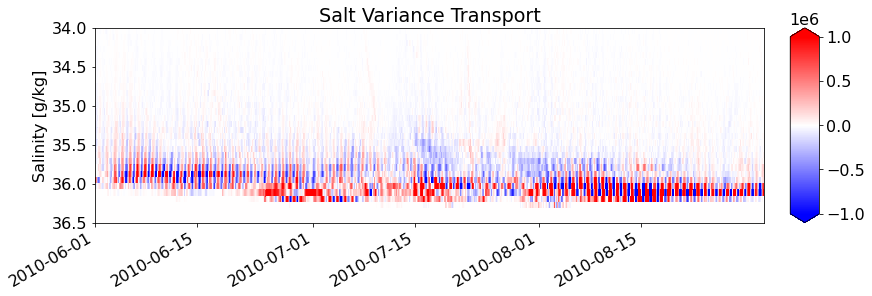

In [88]:
fig, ax = plt.subplots(1,1, figsize = (12,4), constrained_layout = True)


Qsvarslice.plot(y = 'salt_bin', 
                cmap = plt.get_cmap('bwr'),
                cbar_kwargs = {'label': '',
                               'pad': 0.025},
                vmax = 1e6)
ax.set_ylim(34,36.5)
ax.invert_yaxis()
ax.set_xlabel('')
ax.set_ylabel('Salinity [g/kg]')
ax.set_title('Salt Variance Transport')

## Look at surface forcing animations to study eddies

In [90]:
rv = xroms.relative_vorticity(ds.u, ds.v, ds.u.attrs['grid'])
#Interpolate to the rho points. 
rv = grid.interp(rv, 'Z')

fx = grid.interp(ds.f, 'X', boundary = 'extend')
fxy = grid.interp(fx, 'Y', boundary = 'extend')
RVn = rv/fxy

rvload = RVn.isel(s_rho = -1, eta_v = etaslice, xi_u = xislice).sel(ocean_time = slice('2010-06', '2010-08'))

In [3]:
land_10m = cfeature.NaturalEarthFeature('physical', 'land', '10m',
                                edgecolor='face',
                                facecolor=cfeature.COLORS['land'])
states_provinces = cfeature.NaturalEarthFeature(
                   category='cultural',
                   name='admin_1_states_provinces_lines',
                   scale='10m',
                   facecolor='none')

In [ ]:
salslice = ds.salt[0].isel(eta_rho = etaslice)

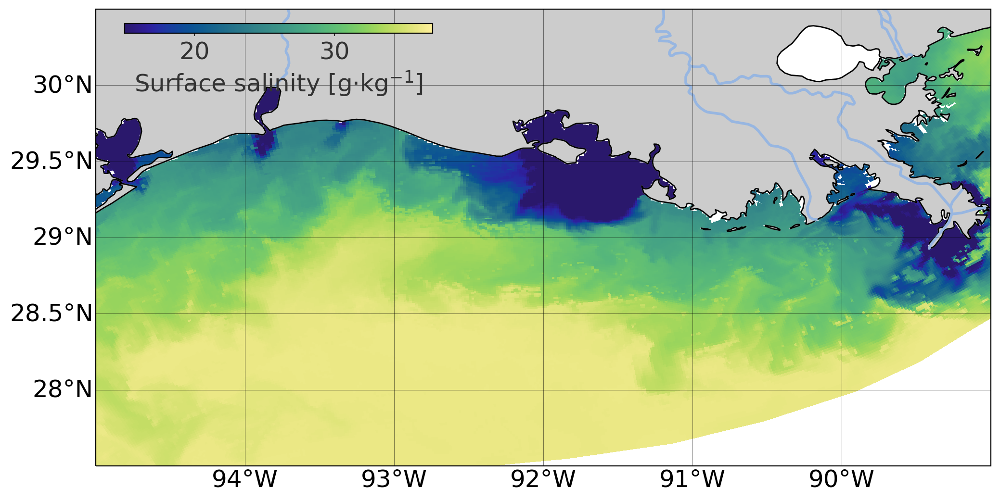

In [108]:
plt.rcParams.update({'font.size': 18})

fig = plt.figure(figsize=(10,5), dpi = 200)
ax = fig.add_axes([0.06, 0.01, 0.93, 0.95], projection=ccrs.PlateCarree(central_longitude=-92.0))


lon_rho = ds.salt['lon_rho']
lat_rho = ds.salt['lat_rho']

hlevs = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]  # isobath contour depths

sal = ds.salt.isel(s_rho = -1).sel(ocean_time = slice('2010-08'))

mappable = ax.pcolormesh(lon_rho, lat_rho, sal[0], 
                         cmap = cmo.haline, 
                         transform = cartopy.crs.PlateCarree(),
                         vmin = 15, vmax = 37)
gl = ax.gridlines(linewidth=0.4, color='black', alpha=0.5, linestyle='-', draw_labels=True)
#     ax.set_extent([-98, -88, 25, 30.5], ccrs.PlateCarree())
ax.set_extent([-95, -89, 27.5, 30.5], ccrs.PlateCarree())
ax.add_feature(land_10m, facecolor='0.8')
ax.coastlines(resolution='10m')  
ax.add_feature(states_provinces, )
ax.add_feature(cfeature.BORDERS, linestyle='-', )
ax.add_feature(cartopy.feature.RIVERS, linewidth = 2)
ax.set_aspect('auto')

cax = fig.add_axes([0.09, 0.91, 0.32, 0.02]) 
cb = fig.colorbar(mappable, cax=cax, orientation='horizontal')
cb.set_label(r'Surface salinity [g$\cdot$kg$^{-1}$]',color='0.2')
cb.ax.tick_params(length=2, color='0.2', labelcolor='0.2')

#Plot isobaths and label the contours

ax.tick_params(axis='y', labelsize=5)

gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.right_labels = False
gl.top_labels = False


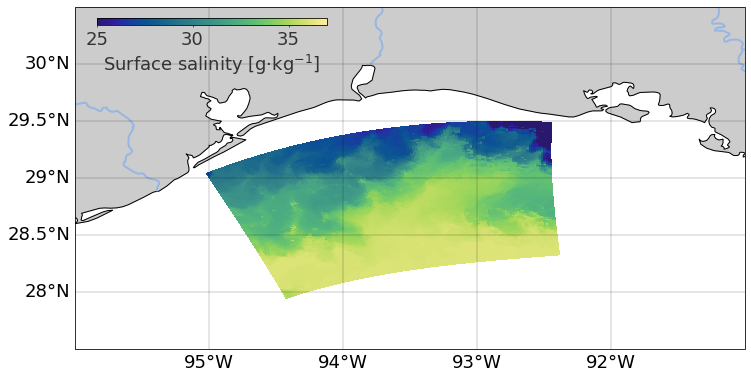

In [66]:
plt.rcParams.update({'font.size': 18})

fig = plt.figure(figsize=(10,5))
ax = fig.add_axes([0.06, 0.01, 0.93, 0.95], projection=ccrs.PlateCarree(central_longitude=-92.0))


lon_rho = ds.salt['lon_rho'].isel(eta_rho = etaslice, xi_rho = xislice)
lat_rho = ds.salt['lat_rho'].isel(eta_rho = etaslice, xi_rho = xislice)

hlevs = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]  # isobath contour depths

sal = ds.salt.isel(s_rho = -1, eta_rho = etaslice, xi_rho = xislice).sel(ocean_time = slice('2010-08'))

mappable = ax.pcolormesh(lon_rho, lat_rho, sal[0], 
                         cmap = cmo.haline, 
                         transform = cartopy.crs.PlateCarree(),
                         vmin = 25, vmax = 37)
gl = ax.gridlines(linewidth=0.4, color='black', alpha=0.5, linestyle='-', draw_labels=True)
#     ax.set_extent([-98, -88, 25, 30.5], ccrs.PlateCarree())
ax.set_extent([-96, -91, 27.5, 30.5], ccrs.PlateCarree())
ax.add_feature(land_10m, facecolor='0.8')
ax.coastlines(resolution='10m')  
ax.add_feature(states_provinces, )
ax.add_feature(cfeature.BORDERS, linestyle='-', )
ax.add_feature(cartopy.feature.RIVERS, linewidth = 2)
ax.set_aspect('auto')

cax = fig.add_axes([0.09, 0.91, 0.32, 0.02]) 
cb = fig.colorbar(mappable, cax=cax, orientation='horizontal')
cb.set_label(r'Surface salinity [g$\cdot$kg$^{-1}$]',color='0.2')
cb.ax.tick_params(length=2, color='0.2', labelcolor='0.2')

#Plot isobaths and label the contours

ax.tick_params(axis='y', labelsize=5)

gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.right_labels = False
gl.top_labels = False


In [20]:
for t in range(10):
    print(t)

0
1
2
3
4
5
6
7
8
9


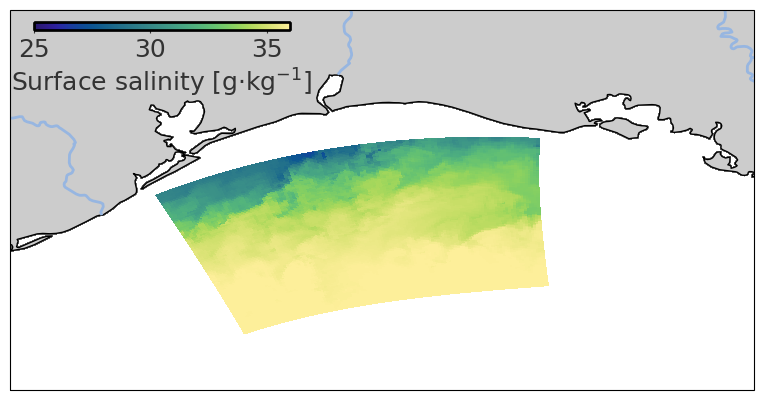

In [56]:
plt.rcParams.update({'font.size': 18})

fig = plt.figure(figsize=(8,4), dpi = 100)
camera = Camera(fig)

ax = fig.add_axes([0.06, 0.01, 0.93, 0.95], projection=ccrs.PlateCarree(central_longitude=-92.0))

lon_rho = ds.salt['lon_rho'].isel(eta_rho = etaslice, xi_rho = xislice)
lat_rho = ds.salt['lat_rho'].isel(eta_rho = etaslice, xi_rho = xislice)

hlevs = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]  # isobath contour depths

sal = ds.salt.isel(s_rho = 0, eta_rho = etaslice, xi_rho = xislice).sel(ocean_time = slice('2010-08'))

test = []
for t in range(30):
    mappable = ax.pcolormesh(lon_rho, lat_rho, sal[t], 
                             cmap = cmo.haline, 
                             transform = cartopy.crs.PlateCarree(),
                             vmin = 25, vmax = 36)
#     gl = ax.gridlines(linewidth=0.4, color='black', alpha=0.5, linestyle='-', draw_labels=True)
#     ax.set_extent([-98, -88, 25, 30.5], ccrs.PlateCarree())
    ax.set_extent([-96, -91, 27.5, 30.5], ccrs.PlateCarree())
    ax.add_feature(land_10m, facecolor='0.8')
    ax.coastlines(resolution='10m')  
    ax.add_feature(states_provinces, )
    ax.add_feature(cfeature.BORDERS, linestyle='-', )
    ax.add_feature(cartopy.feature.RIVERS, linewidth = 2)
    ax.set_aspect('auto')

    cax = fig.add_axes([0.09, 0.91, 0.32, 0.02]) 
    cb = fig.colorbar(mappable, cax=cax, orientation='horizontal')
    cb.set_label(r'Surface salinity [g$\cdot$kg$^{-1}$]', color='0.2')
    cb.ax.tick_params(length=2, color='0.2', labelcolor='0.2')
    
    #Plot isobaths and label the contours

    ax.tick_params(axis='y', labelsize=13)

    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    gl.right_labels = False
    gl.top_labels = False
    test.append(fig)
#     fig.savefig('sal_2010_08_%d.png') %t
#     camera.snap()
    
# animation = camera.animate()
# plt.close()
# animation.save('test.gif', fps = 20)

In [63]:
for i in range(len(test)):
    test[i].savefig('animations/test_%s.png') %i

TypeError: unsupported operand type(s) for %: 'NoneType' and 'int'

In [64]:
test

[<Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2 Axes>,
 <Figure size 800x400 with 2

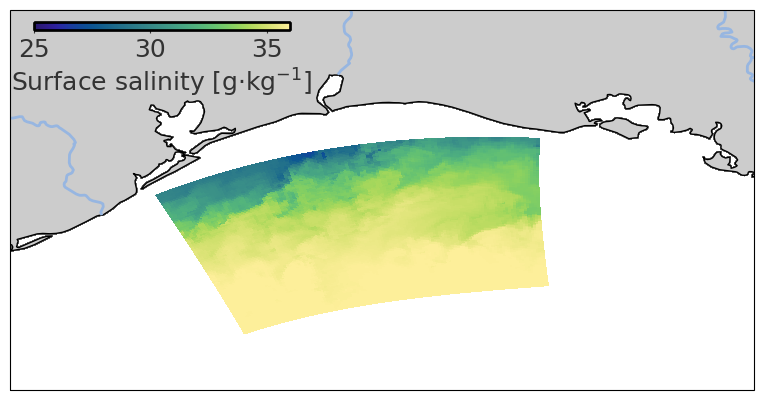

In [58]:
test[29].savefig()

In [54]:
# from IPython.display import HTML
# HTML(animation.to_html5_video())

In [ ]:
fig = plt.figure(figsize=(10,5), dpi = 600)
ax = fig.add_axes([0.06, 0.01, 0.93, 0.95], projection=ccrs.PlateCarree(central_longitude=-85.0))

lon = ds.salt['lon_u'].isel(eta_rho = etaslice, xi_rho = xislice)
lat = ds.salt['lat_v'].isel(eta_rho = etaslice, xi_rho = xislice)

hlevs = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]  # isobath contour depths

mappable = ax.pcolormesh(lon_rho, lat_rho, sal, 
                         cmap = cmo.haline, 
                         transform = cartopy.crs.PlateCarree(),
                         vmin = 15, vmax = 35)

gl = ax.gridlines(linewidth=0.4, color='black', alpha=0.5, linestyle='-', draw_labels=True)
ax.set_extent([-95, -88.5, 28, 30.5], ccrs.PlateCarree())
# ax.set_extent([-94.5, -93.5, 27, 30.5], ccrs.PlateCarree())
ax.add_feature(land_10m, facecolor='0.8')
ax.coastlines(resolution='10m')  
ax.add_feature(states_provinces, )
ax.add_feature(cfeature.BORDERS, linestyle='-', )
ax.add_feature(cartopy.feature.RIVERS, linewidth = 2)
ax.set_aspect('auto')

cax = fig.add_axes([0.09, 0.91, 0.32, 0.02]) 
cb = fig.colorbar(mappable, cax=cax, orientation='horizontal')
# cb.set_label(r'Surface Salinity [g$\cdot$ kg$^{-1}$]',fontsize=18,  )
cb.set_label(r' Normalized Relative vorticity [s$^{-1}$]',fontsize=18,  )
cb.ax.tick_params(labelsize=18, length=2, color='0.2', labelcolor='0.2')
#Plot isobaths and label the contours
CS = ax.contour(lon_rho, lat_rho, ds.h, hlevs, 
                colors='1', transform=ccrs.PlateCarree(), 
                inline = 1, linewidths=1)

ax.tick_params(axis='y', labelsize=18)
gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.right_labels = False
gl.bottom_labels = False

### Calculate entrainment. First, look at the volume integrated quantities and their derivatives in salinity coordinates

In [135]:
volhists = xr.open_mfdataset('/scratch/user/dylan.schlichting/tef/largecv/entrainment/*.nc').sel(ocean_time = slice('2010-06', '2010-08'))

dVdts = volhists.dV_saltcoord.diff('ocean_time')/3600
dVsdts = volhists.dVs_saltcoord.diff('ocean_time')/3600

Text(0, 0.5, 'Salinity [g/kg]')

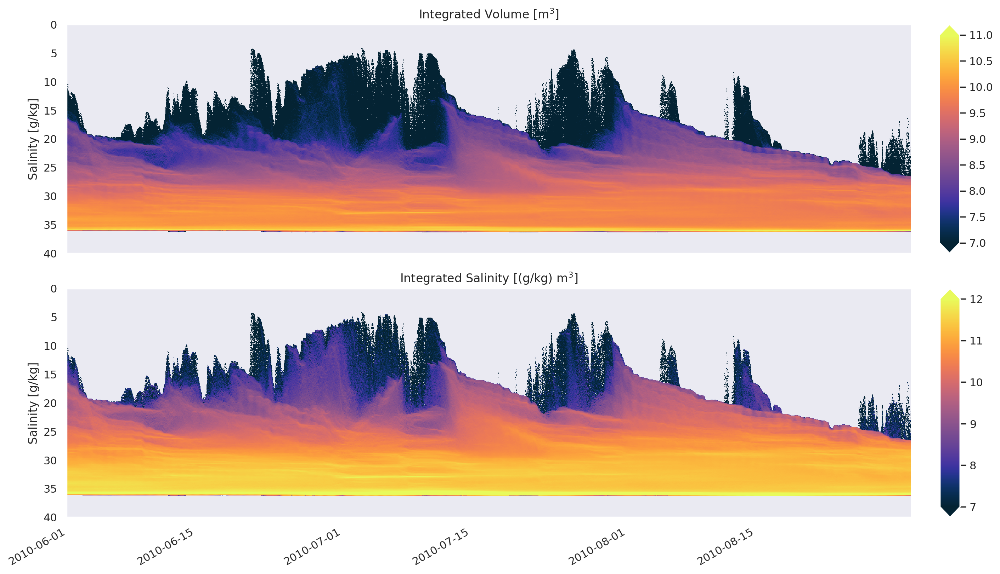

In [136]:
volhists = xr.open_mfdataset('/scratch/user/dylan.schlichting/tef/largecv/entrainment/*.nc').sel(ocean_time = slice('2010-06', '2010-08'))

plt.rcParams.update({'font.size': 15})

fig, ax = plt.subplots(2, figsize = (14,8), constrained_layout = True, dpi = 200)

np.log10(volhists.dV_saltcoord).plot(ax = ax[0],
                                     y = 'salt_bin', 
                                     cmap = cmo.thermal, 
                                     vmin = 7, vmax = 11,
                                     cbar_kwargs = {'label': '',
                                               'pad': 0.025})

np.log10(volhists.dVs_saltcoord).plot(ax = ax[1],
                                     y = 'salt_bin', 
                                     cmap = cmo.thermal, 
                                     vmin = 7, vmax = 12,
                                    cbar_kwargs = {'label': '',
                                               'pad': 0.025})
ax[0].invert_yaxis()
ax[0].set_xlabel('')
ax[0].set_title('Integrated Volume [m$^3$]')
ax[0].set_ylabel('Salinity [g/kg]')
ax[0].axes.xaxis.set_ticklabels([])

ax[1].invert_yaxis()
ax[1].set_xlabel('')
ax[1].set_title('Integrated Salinity [(g/kg) m$^3$]')
ax[1].set_ylabel('Salinity [g/kg]')

Text(0, 0.5, 'Salinity [g/kg]')

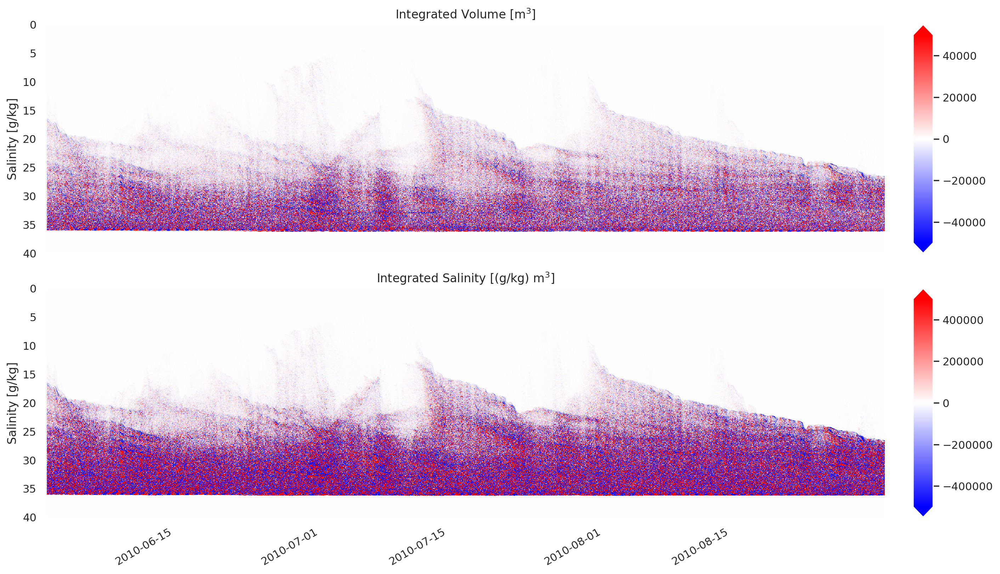

In [137]:
plt.rcParams.update({'font.size': 15})

fig, ax = plt.subplots(2, figsize = (14,8), constrained_layout = True, dpi = 200)

dVdts.plot(ax = ax[0],
           y = 'salt_bin', 
           cmap = plt.get_cmap('bwr'),
           vmax = 50000,
           cbar_kwargs = {'label': '',
                   'pad': 0.025})

dVsdts.plot(ax = ax[1],
             y = 'salt_bin', 
             cmap = plt.get_cmap('bwr'),
             vmax = 500000,
             cbar_kwargs = {'label': '',
                       'pad': 0.025})
ax[0].invert_yaxis()
ax[0].set_xlabel('')
ax[0].set_title('Integrated Volume [m$^3$]')
ax[0].set_ylabel('Salinity [g/kg]')
ax[0].axes.xaxis.set_ticklabels([])

ax[1].invert_yaxis()
ax[1].set_xlabel('')
ax[1].set_title('Integrated Salinity [(g/kg) m$^3$]')
ax[1].set_ylabel('Salinity [g/kg]')

In [138]:
tefslice = tef.sel(ocean_time = slice('2010-06', '2010-08'))

In [139]:
Qe = tefslice.Qnet-dVdts
Qes = tefslice.Qsnet-dVsdts

Text(0, 0.5, 'Salinity [g/kg]')

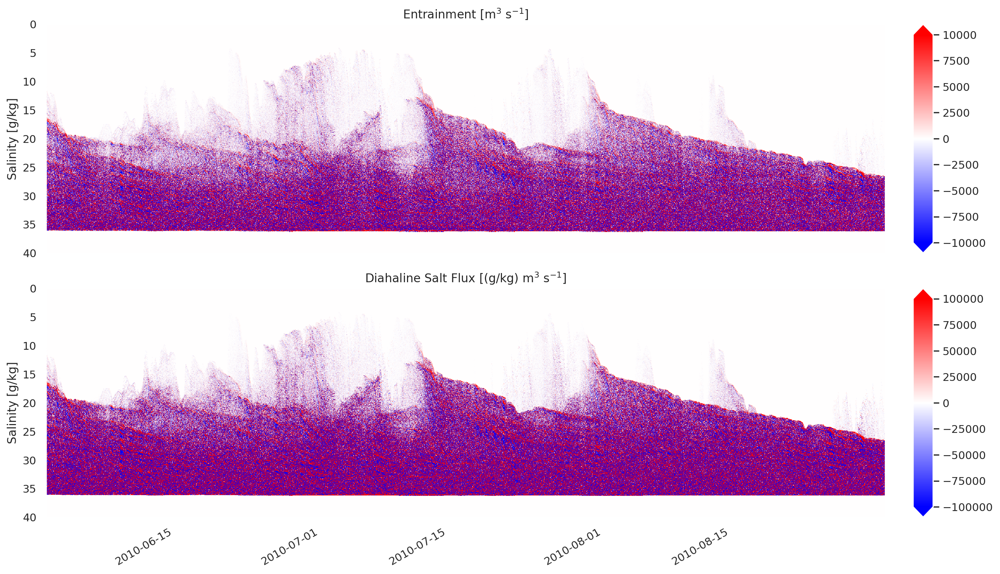

In [140]:
plt.rcParams.update({'font.size': 15})

fig, ax = plt.subplots(2, figsize = (14,8), constrained_layout = True, dpi = 200)

Qe.plot(ax = ax[0],
           y = 'salt_bin', 
           cmap = plt.get_cmap('bwr'),
           vmax = 10000,
           cbar_kwargs = {'label': '',
                   'pad': 0.025})

Qes.plot(ax = ax[1],
             y = 'salt_bin', 
             cmap = plt.get_cmap('bwr'),
             vmax = 100000,
             cbar_kwargs = {'label': '',
                       'pad': 0.025})
ax[0].invert_yaxis()
ax[0].set_xlabel('')
ax[0].set_title('Entrainment [m$^3$ s$^{-1}$]')
ax[0].set_ylabel('Salinity [g/kg]')
ax[0].axes.xaxis.set_ticklabels([])

ax[1].invert_yaxis()
ax[1].set_xlabel('')
ax[1].set_title('Diahaline Salt Flux [(g/kg) m$^3$ s$^{-1}$]')
ax[1].set_ylabel('Salinity [g/kg]')

### So the time-salinity plots of entrainment and diahaline salt flux look noisy - which is expected. What about salinity coordiantes?

In [141]:
ds = tefslice.salt_bin[1]-tefslice.salt_bin[0]
dQds = tefslice.Qnet.diff('salt_bin')/ds

In [142]:
chislice = chi.sel(ocean_time = slice('2010-06', '2010-08'))

Text(0.5, 1.0, '$\\chi$ [m$^3$ s$^{-1}$ (g kg$^{-1}$)]')

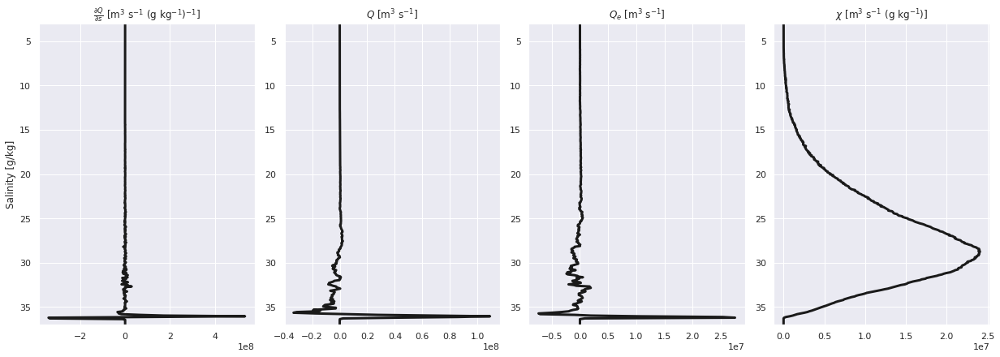

In [143]:
plt.rcParams.update({'font.size': 16})

fig, ax = plt.subplots(1,4 ,figsize = (17,6), constrained_layout = True)

dQds.sum('ocean_time').plot(ax = ax[0], 
           y = 'salt_bin', 
           ylim = (3,37),
           c = 'k',
           lw = 3)

ax[0].invert_yaxis()
ax[0].set_xlabel('')
ax[0].set_title(r'$\frac{\partial Q}{\partial s}$ [m$^3$ s$^{-1}$ (g kg$^{-1}$)$^{-1}$]')
ax[0].set_ylabel('Salinity [g/kg]')

tef.Qnet.sum('ocean_time').plot(ax = ax[1], 
           y = 'salt_bin', 
           ylim = (3,37),
           c = 'k',
           lw = 3)

ax[1].invert_yaxis()
ax[1].set_xlabel('')
ax[1].set_title(r'$Q$ [m$^3$ s$^{-1}$]')
ax[1].set_ylabel('')

Qe.sum('ocean_time').plot(ax = ax[2], 
           y = 'salt_bin', 
           ylim = (3,37),
           c = 'k',
           lw = 3)

ax[2].invert_yaxis()
ax[2].set_xlabel('')
ax[2].set_title('$Q_e$ [m$^3$ s$^{-1}$]')
ax[2].set_ylabel('')

chislice.sum('ocean_time').plot(ax = ax[3], 
             y = 'salt_bin', 
             ylim = (3,37),
             c = 'k',
             lw = 3)

ax[3].invert_yaxis()
ax[3].set_xlabel('')
ax[3].set_ylabel('')
ax[3].set_title(r'$\chi$ [m$^3$ s$^{-1}$ (g kg$^{-1}$)]')


Text(0.5, 1.0, 'Normalized $\\chi$')

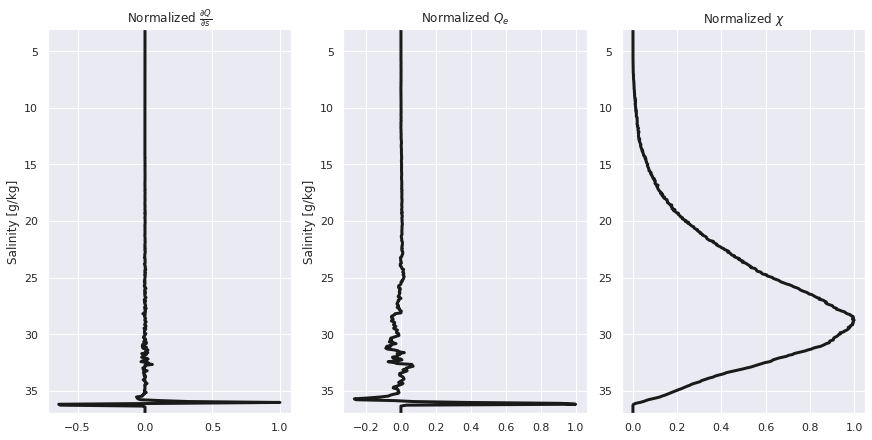

In [144]:
plt.rcParams.update({'font.size': 16})

fig, ax = plt.subplots(1,3 ,figsize = (12,6), constrained_layout = True)

dQdsnorm = (dQds.sum('ocean_time')/(dQds.sum('ocean_time').max()))
dQdsnorm.plot(ax = ax[0], 
           y = 'salt_bin', 
           ylim = (3,37),
           c = 'k',
           lw = 3)

ax[0].invert_yaxis()
ax[0].set_xlabel('')
ax[0].set_title(r'Normalized $\frac{\partial Q}{\partial s}$')
ax[0].set_ylabel('Salinity [g/kg]')

Qenorm = (Qe.sum('ocean_time')/(Qe.sum('ocean_time').max()))
Qenorm.plot(ax = ax[1], 
           y = 'salt_bin', 
           ylim = (3,37),
           c = 'k',
           lw = 3)

ax[1].invert_yaxis()
ax[1].set_xlabel('')
ax[1].set_title('Normalized $Q_e$')
ax[1].set_ylabel('Salinity [g/kg]')

chinorm = (chislice.sum('ocean_time')/(chislice.sum('ocean_time').max()))
chinorm.plot(ax = ax[2], 
             y = 'salt_bin', 
             ylim = (3,37),
             c = 'k',
             lw = 3)

ax[2].invert_yaxis()
ax[2].set_xlabel('')
ax[2].set_ylabel('')
ax[2].set_title('Normalized $\chi$')


Text(0, 0.5, 'Salinity [g/kg]')

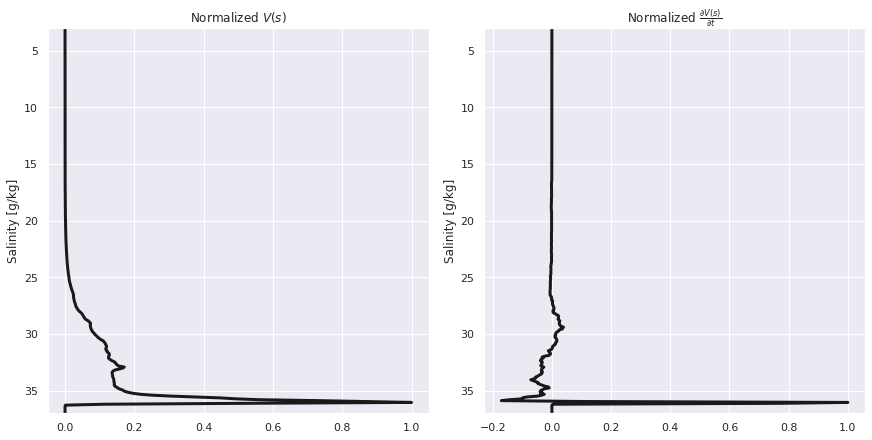

In [145]:
plt.rcParams.update({'font.size': 16})

fig, ax = plt.subplots(1,2 ,figsize = (12,6), constrained_layout = True)

dVnorm = (volhists.dV_saltcoord.sum('ocean_time')/(volhists.dV_saltcoord.sum('ocean_time').max()))
dVnorm.plot(ax = ax[0], 
           y = 'salt_bin', 
           ylim = (3,37),
           c = 'k',
           lw = 3)

ax[0].invert_yaxis()
ax[0].set_xlabel('')
ax[0].set_title(r'Normalized $V(s)$')
ax[0].set_ylabel('Salinity [g/kg]')

dVdtsnorm = (dVdts.sum('ocean_time')/(dVdts.sum('ocean_time').max()))
dVdtsnorm.plot(ax = ax[1], 
           y = 'salt_bin', 
           ylim = (3,37),
           c = 'k',
           lw = 3)

ax[1].invert_yaxis()
ax[1].set_xlabel('')
ax[1].set_title(r'Normalized $\frac{\partial V(s)}{\partial t}$')
ax[1].set_ylabel('Salinity [g/kg]')

Text(0, 0.5, 'Salinity [g/kg]')

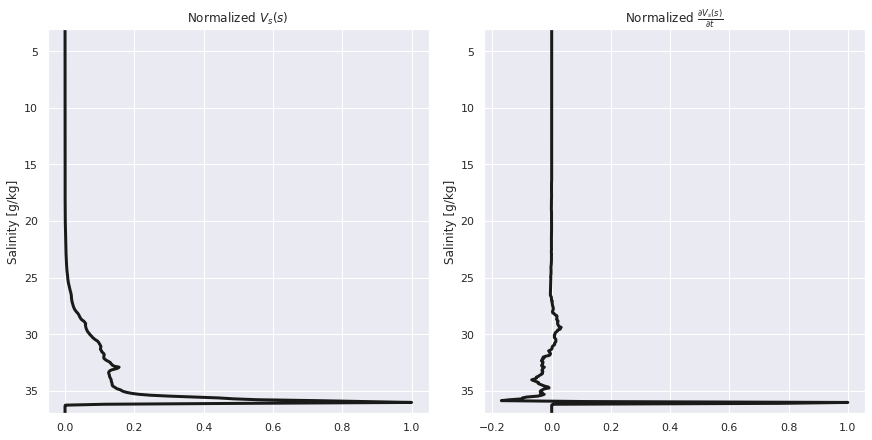

In [146]:
plt.rcParams.update({'font.size': 16})

fig, ax = plt.subplots(1,2 ,figsize = (12,6), constrained_layout = True)

dVsnorm = (volhists.dVs_saltcoord.sum('ocean_time')/(volhists.dVs_saltcoord.sum('ocean_time').max()))
dVsnorm.plot(ax = ax[0], 
           y = 'salt_bin', 
           ylim = (3,37),
           c = 'k',
           lw = 3)

ax[0].invert_yaxis()
ax[0].set_xlabel('')
ax[0].set_title(r'Normalized $V_s(s)$')
ax[0].set_ylabel('Salinity [g/kg]')

dVsdtsnorm = (dVsdts.sum('ocean_time')/(dVsdts.sum('ocean_time').max()))
dVsdtsnorm.plot(ax = ax[1], 
           y = 'salt_bin', 
           ylim = (3,37),
           c = 'k',
           lw = 3)

ax[1].invert_yaxis()
ax[1].set_xlabel('')
ax[1].set_title(r'Normalized $\frac{\partial V_s(s)}{\partial t}$')
ax[1].set_ylabel('Salinity [g/kg]')



### Calculate the integral relationships first. 

In [147]:
rhs = ((tefslice.Qnet[1:].sum('ocean_time')-dVdts.sum('ocean_time')).diff('salt_bin'))/ds

Text(0.5, 0, '[(g kg$^{-1}$)^2 m$^3$ s$^{-1}$]')

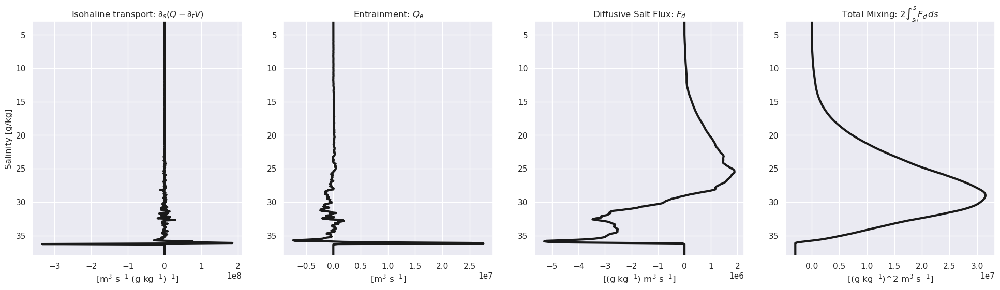

In [148]:
plt.rcParams.update({'font.size': 16})

fig, ax = plt.subplots(1,4 ,figsize = (24,6), dpi = 100)

(rhs).plot(ax = ax[0], 
           y = 'salt_bin', 
           ylim = (3,38),
           c = 'k',
           lw = 3)

ax[0].invert_yaxis()
ax[0].set_xlabel('')
# ax[0].set_title(r'$\frac{\partial Q}{\partial s}$ [m$^3$ s$^{-1}$ (g kg$^{-1}$)$^{-1}$]')
ax[0].set_ylabel('Salinity [g/kg]')

Qeint = ((rhs*ds)).cumsum('salt_bin')
Qeint.plot(ax = ax[1], 
           y = 'salt_bin', 
           ylim = (3,38),
           c = 'k',
           lw = 3)

ax[1].invert_yaxis()
ax[1].set_xlabel('')
# ax[1].set_title('$Q_e$ [m$^3$ s$^{-1}$]')
ax[1].set_ylabel('')

Fmint = (Qeint*ds).cumsum('salt_bin')
Fmint.plot(ax = ax[2], 
             y = 'salt_bin', 
             ylim = (3,38),
             c = 'k',
             lw = 3)

ax[2].invert_yaxis()
ax[2].set_xlabel('')
ax[2].set_ylabel('')

resmix = 2*((Fmint*ds).cumsum('salt_bin'))
resmix.plot(ax = ax[3], 
             y = 'salt_bin', 
             ylim = (3,38),
             c = 'k',
             lw = 3)

ax[3].invert_yaxis()
ax[3].set_xlabel('')
ax[3].set_ylabel('')
# ax[2].set_title(r'$\chi$ [m$^3$ s$^{-1}$ (g kg$^{-1}$)]')

ax[0].set_title(r'Isohaline transport: $\partial_s (Q- \partial_t V)$')
ax[1].set_title('Entrainment: $Q_e$')
ax[2].set_title(r'Diffusive Salt Flux: $F_d$')
ax[3].set_title(r'Total Mixing: 2$\int_{s_0}^{s} F_d \, ds$')

ax[0].set_xlabel(r'[m$^3$ s$^{-1}$ (g kg$^{-1}$)$^{-1}$]')
ax[1].set_xlabel('[m$^3$ s$^{-1}$]')
ax[2].set_xlabel('[(g kg$^{-1}$) m$^3$ s$^{-1}$]')
ax[3].set_xlabel(r'[(g kg$^{-1}$)^2 m$^3$ s$^{-1}$]')


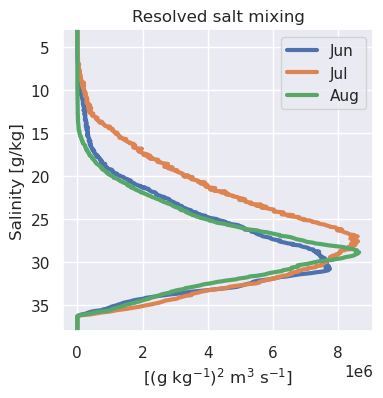

In [156]:
fig,ax = plt.subplots(1, figsize = (4,4), dpi = 100)

chijune = chislice.sel(ocean_time = '2010-06')
chijuly = chislice.sel(ocean_time = '2010-07')
chiaug = chislice.sel(ocean_time = '2010-08')

chijune.sum('ocean_time').plot(y = 'salt_bin', 
                               ylim = (3,38),
                               lw = 3,
                               label = 'Jun'
                                    )
chijuly.sum('ocean_time').plot(y = 'salt_bin', 
                               ylim = (3,38),
                               lw = 3,
                               label = 'Jul'
                                    )
chiaug.sum('ocean_time').plot(y = 'salt_bin', 
                               ylim = (3,38),
                               lw = 3,
                               label = 'Aug'
                                    )
plt.xlabel(r'[(g kg$^{-1}$)$^2$ m$^3$ s$^{-1}$]')
plt.ylabel('Salinity [g/kg]')
plt.title('Resolved salt mixing')
ax.invert_yaxis()
plt.legend()

In [196]:
fig,ax = plt.subplots(1, figsize = (4,6))

resmix.plot(y = 'salt_bin', 
            ylim = (3,38),
            c = 'k',
            lw = 3,
            label = 'Total Mixing: 2$\int_{s_0}^{s} F_d \, ds$')

chislice[1:].sum('ocean_time').plot(y = 'salt_bin', 
                                    ylim = (3,38),
                                    c = 'r',
                                    lw = 3,
                                    label = 'Resolved Mixing: $\chi$')


plt.legend(bbox_to_anchor=(1.0, 1.00))
plt.xlabel(r'[(g kg$^{-1}$)$^2$ m$^3$ s$^{-1}$]')
plt.ylabel('Salinity [g/kg]')
plt.title('Mixing comparison')
ax.invert_yaxis()

array(-2996529.22842233)

In [150]:
resmix

<xarray.DataArray (salt_bin: 499)>
dask.array<mul, shape=(499,), dtype=float64, chunksize=(499,), chunktype=numpy.ndarray>
Coordinates:
  * salt_bin  (salt_bin) float64 0.12 0.2 0.28 0.36 ... 39.72 39.8 39.88 39.96

### Redo the integral relationships, but leave the time dimension for instantaneous comparison.

In [128]:
rhs1 = ((tefslice.Qnet[1:]-dVdts).diff('salt_bin'))/ds

Qeint1 = ((rhs1*ds)).cumsum('salt_bin')

Fmint1 = (Qeint1*ds).cumsum('salt_bin')

resmix1 = 2*((Fmint1*ds).cumsum('salt_bin'))

NameError: name 'dVdts' is not defined

### First - check the salinity variance budget and see how using the total mixing compares

NameError: name 'storageslice' is not defined

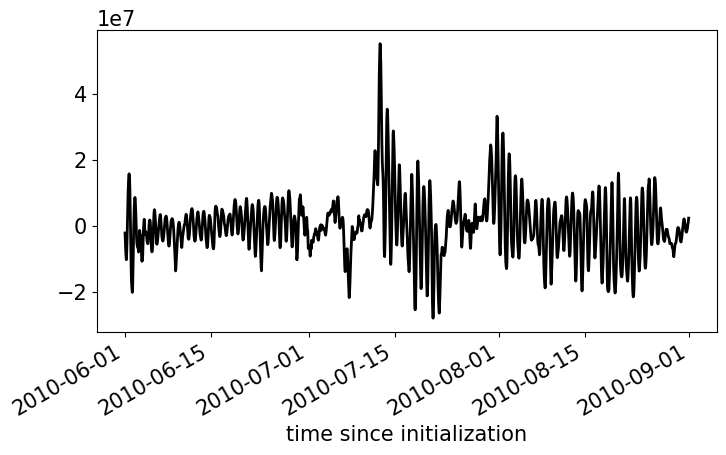

In [37]:
fig = plt.subplots(1, figsize = (8,4), dpi = 100)
# chislice.sum('salt_bin')
# resmix1[:,:430].sum('salt_bin')
(tefslice.svaradv[1:]-chislice[1:].sum('salt_bin')).plot(lw=2, color='k', label=r'$Q_{in}s \prime^2_{in}+Q_{out}s \prime^2_{out}-\chi$')
# (tef.ssaltadv).plot(lw=2, color='r', label=r'$Q_{in}s^2_{in}+Q_{out}s^2_{out}$')
storageslice.dsvardt[1:].plot(lw=2, color='r', label=r'$\frac{\partial (s \prime^2V)}{\partial t}$')
# chi_hourly.chi.plot(lw = 1.5, color = 'c', label = '$\chi$')

plt.xlabel('')
plt.ylabel(r'[psu$^2 m^3 s^{-1}$]')
plt.legend(bbox_to_anchor=(1.5, 1.05))
plt.title('Salt Variance Budget - No Surface Forcing')

In [303]:
(storageslice.dVdt.sum()-tefslice.voladv.sum())/(storageslice.dVdt.sum()).values*100

<xarray.DataArray ()>
array(-1.1407627)

Text(0.5, 1.0, 'Volume Budget - No Surface Forcing')

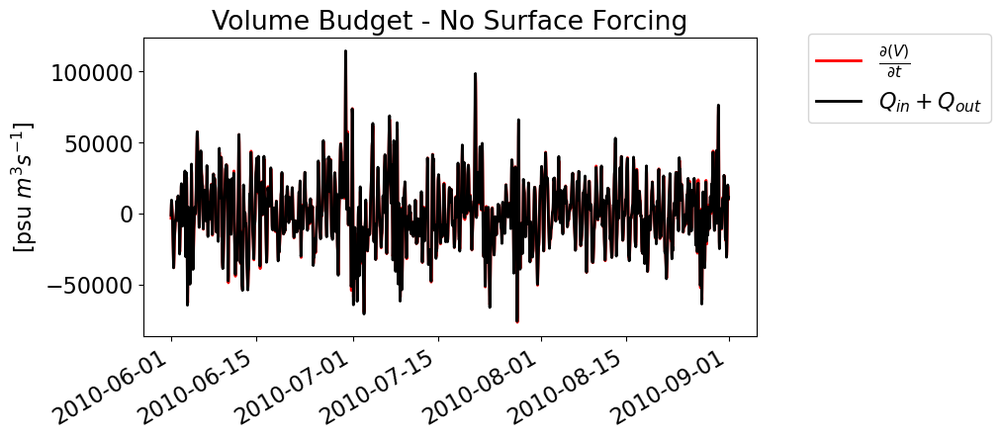

In [297]:
fig = plt.subplots(1, figsize = (8,4), dpi=100)

(storageslice.dVdt).plot(lw=2, color='r', label=r'$\frac{\partial (V)}{\partial t}$')
(tefslice.voladv).plot(lw=2, color='k', label = r'$Q_{in}+Q_{out}$')

plt.xlabel('')
plt.ylabel(r'[psu $m^3 s^{-1}$]')
plt.legend(bbox_to_anchor=(1.4, 1.05))
plt.title('Volume Budget - No Surface Forcing')

Text(0.5, 1.0, 'Salt Variance Budget - No Surface Forcing')

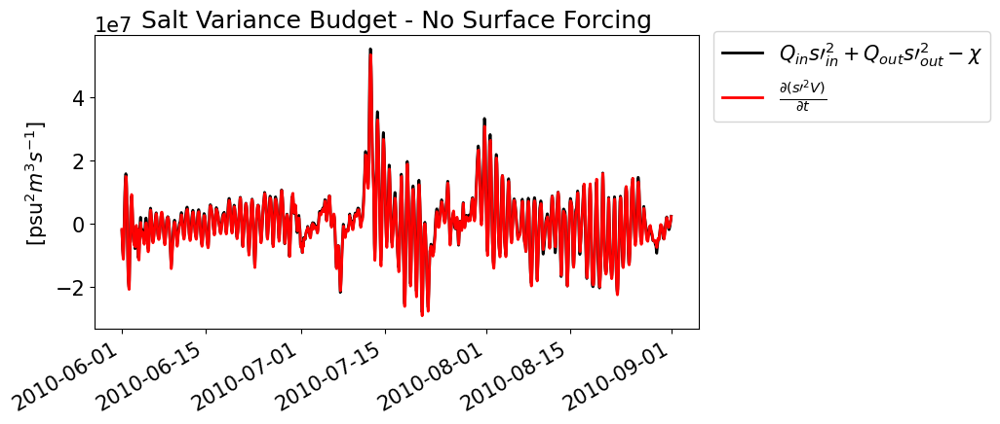

In [39]:
storageslice = storage.sel(ocean_time = slice('2010-06', '2010-08'))


fig = plt.subplots(1, figsize = (8,4), dpi = 100)
# chislice.sum('salt_bin')
# resmix1[:,:430].sum('salt_bin')
(tefslice.svaradv[1:]-chislice[1:].sum('salt_bin')).plot(lw=2, color='k', label=r'$Q_{in}s \prime^2_{in}+Q_{out}s \prime^2_{out}-\chi$')
# (tef.ssaltadv).plot(lw=2, color='r', label=r'$Q_{in}s^2_{in}+Q_{out}s^2_{out}$')
storageslice.dsvardt[1:].plot(lw=2, color='r', label=r'$\frac{\partial (s \prime^2V)}{\partial t}$')
# chi_hourly.chi.plot(lw = 1.5, color = 'c', label = '$\chi$')

plt.xlabel('')
plt.ylabel(r'[psu$^2 m^3 s^{-1}$]')
plt.legend(bbox_to_anchor=(1.5, 1.05))
plt.title('Salt Variance Budget - No Surface Forcing')

In [295]:
(tefslice.svaradv[1:]-(resmix1[:,:440].sum('salt_bin'))).sum().values

array(-3.32631861e+08)

In [275]:
chislice[1:].sum().values

array(3.11690603e+09)

In [265]:
storageslice.dsvardt[1:].sum().values

array(-4.53129998e+08)

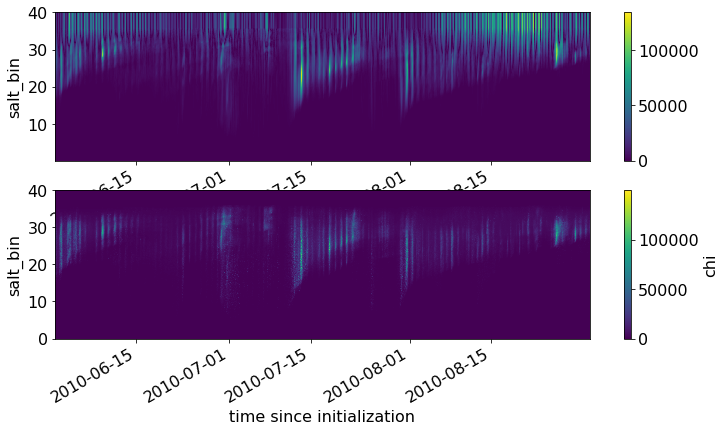

In [14]:
fig, ax = plt.subplots(2,1, figsize = (12,6))
np.abs(resmix1).plot(y = 'salt_bin', ax = ax[0])

chislice[1:].plot(y = 'salt_bin', ax = ax[1])

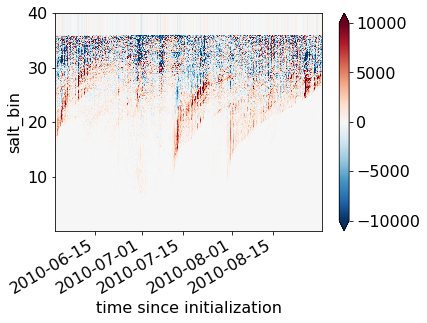

In [222]:
Fmint1.plot(vmax = 10000, y = 'salt_bin')

In [79]:
np.where(rhs1.sum('ocean_time')==0)

(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50, 454,
        455, 456, 457, 458, 459, 460, 461, 462, 463, 464, 465, 466, 467,
        468, 469, 470, 471, 472, 473, 474, 475, 476, 477, 478, 479, 480,
        481, 482, 483, 484, 485, 486, 487, 488, 489, 490, 491, 492, 493,
        494, 495, 496, 497, 498]),)

In [15]:
rhs1 = ((tefslice.Qnet[1:, :454]-dVdts).diff('salt_bin'))/ds

Qeint1 = ((rhs1[:,:]*ds)).cumsum('salt_bin')

Fmint1 = (Qeint1*ds).cumsum('salt_bin')

resmix1 = 2*((Fmint1*ds).cumsum('salt_bin'))

### Test symmetric log scaling. First normalize the data by their maximum value

Text(0, 0.5, 'Salinity [g/kg]')

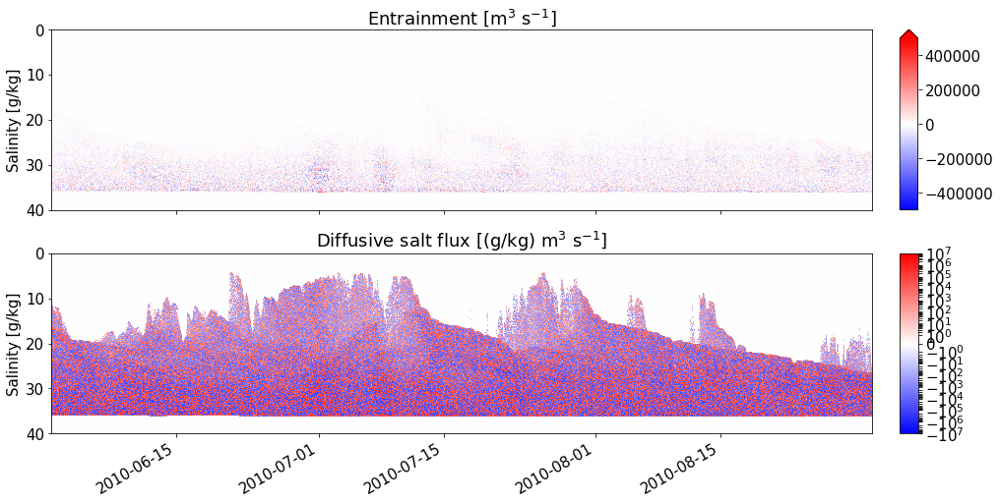

In [81]:
plt.rcParams.update({'font.size': 15})

fig, ax = plt.subplots(2, figsize = (14,7), constrained_layout = True)

Qeint1norm = Qeint1/(np.abs(Qeint1.min()))
Qe.plot(ax = ax[0],
                y = 'salt_bin', 
                cmap = plt.get_cmap('bwr'),
                vmax = 500000,
                cbar_kwargs = {'label': '',
                       'pad': 0.025})

Qe.plot(ax = ax[1],
                y = 'salt_bin', 
                cmap = plt.get_cmap('bwr'),
                norm = colors.SymLogNorm(linthresh=1, linscale=1,
                                              vmin=-10000000, vmax=10000000),
                cbar_kwargs = {'label': '',
                       'pad': 0.025},
                )

ax[0].invert_yaxis()
ax[0].set_xlabel('')
ax[0].set_title('Entrainment [m$^3$ s$^{-1}$]')
ax[0].set_ylabel('Salinity [g/kg]')
ax[0].axes.xaxis.set_ticklabels([])

ax[1].invert_yaxis()
ax[1].set_xlabel('')
ax[1].set_title('Diffusive salt flux [(g/kg) m$^3$ s$^{-1}$]')
ax[1].set_ylabel('Salinity [g/kg]')
# ax[1].axes.xaxis.set_ticklabels([])

Text(0, 0.5, 'Salinity [g/kg]')

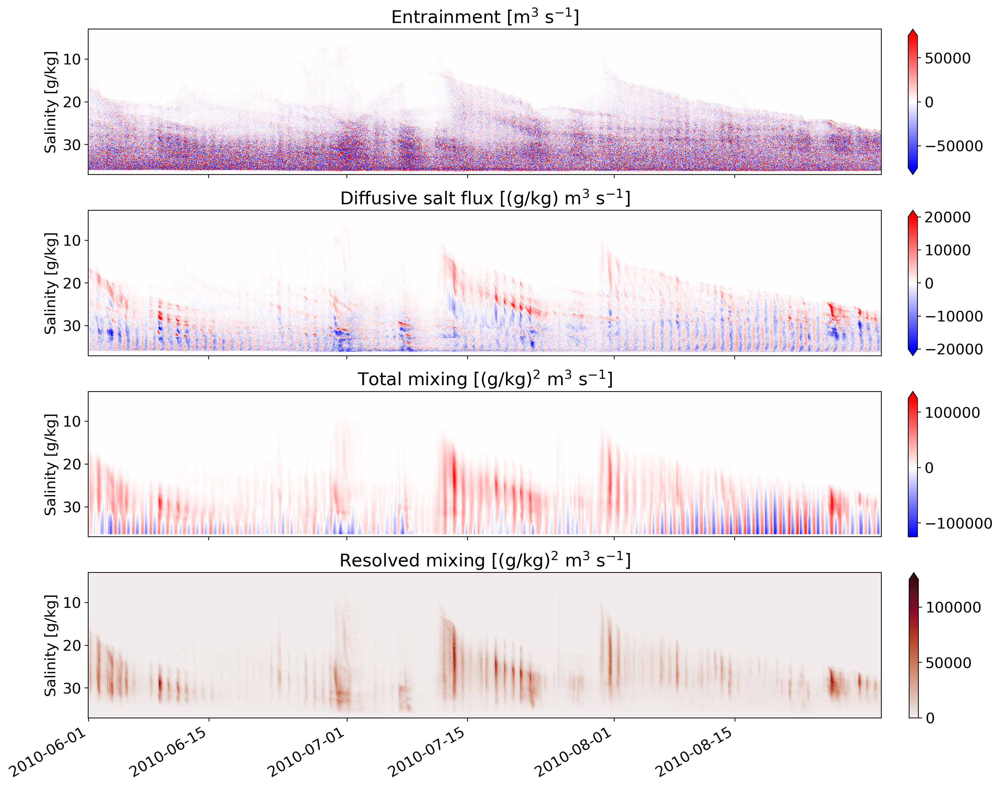

In [27]:
plt.rcParams.update({'font.size': 15})

fig, ax = plt.subplots(4, figsize = (14,11), constrained_layout = True, dpi = 200)

Qeint1.plot(ax = ax[0],
           y = 'salt_bin', 
           cmap = plt.get_cmap('bwr'),
           vmax = 75000,
           cbar_kwargs = {'label': '',
                   'pad': 0.025})

Fmint1.plot(ax = ax[1],
             y = 'salt_bin', 
             cmap = plt.get_cmap('bwr'),
             vmax = 20000,
             cbar_kwargs = {'label': '',
                       'pad': 0.025})

resmix1.plot(ax = ax[2],
             y = 'salt_bin', 
             cmap = plt.get_cmap('bwr'),
             vmax = 125000,
             cbar_kwargs = {'label': '',
                       'pad': 0.025})

chislice.plot(ax = ax[3],
             y = 'salt_bin', 
             cmap = cmo.amp,
             vmax = 125000,
             cbar_kwargs = {'label': '',
                       'pad': 0.025})

for axs in ax.reshape(-1): 
    axs.set_ylabel('Salinity [g/kg]')
    axs.set_xlabel('')
    axs.set_ylim(3,37)
    
ax[0].invert_yaxis()
ax[0].set_title('Entrainment [m$^3$ s$^{-1}$]')
ax[0].axes.xaxis.set_ticklabels([])

ax[1].invert_yaxis()
ax[1].set_title('Diffusive salt flux [(g/kg) m$^3$ s$^{-1}$]')
ax[1].axes.xaxis.set_ticklabels([])

ax[2].invert_yaxis()
ax[2].set_title('Total mixing [(g/kg)$^2$ m$^3$ s$^{-1}$]')
ax[2].axes.xaxis.set_ticklabels([])

ax[3].invert_yaxis()
ax[3].set_xlabel('')
ax[3].set_title('Resolved mixing [(g/kg)$^2$ m$^3$ s$^{-1}$]')
ax[3].set_ylabel('Salinity [g/kg]')

Text(0.5, 0, '[(g kg$^{-1}$)^2 m$^3$ s$^{-1}$]')

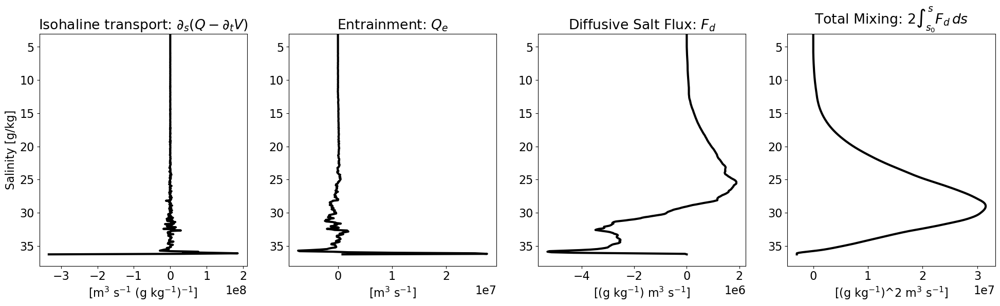

In [91]:
plt.rcParams.update({'font.size': 16})

fig, ax = plt.subplots(1,4 ,figsize = (24,6), dpi = 100)

(rhs1.sum('ocean_time')).plot(ax = ax[0], 
           y = 'salt_bin', 
           ylim = (3,38),
           c = 'k',
           lw = 3)

ax[0].invert_yaxis()
ax[0].set_xlabel('')
# ax[0].set_title(r'$\frac{\partial Q}{\partial s}$ [m$^3$ s$^{-1}$ (g kg$^{-1}$)$^{-1}$]')
ax[0].set_ylabel('Salinity [g/kg]')

(Qeint1.sum('ocean_time')).plot(ax = ax[1], 
           y = 'salt_bin', 
           ylim = (3,38),
           c = 'k',
           lw = 3)

ax[1].invert_yaxis()
ax[1].set_xlabel('')
# ax[1].set_title('$Q_e$ [m$^3$ s$^{-1}$]')
ax[1].set_ylabel('')

(Fmint1.sum('ocean_time')).plot(ax = ax[2], 
             y = 'salt_bin', 
             ylim = (3,38),
             c = 'k',
             lw = 3)

ax[2].invert_yaxis()
ax[2].set_xlabel('')
ax[2].set_ylabel('')

resmix1.sum('ocean_time').plot(ax = ax[3], 
             y = 'salt_bin', 
             ylim = (3,38),
             c = 'k',
             lw = 3)

ax[3].invert_yaxis()
ax[3].set_xlabel('')
ax[3].set_ylabel('')
# ax[2].set_title(r'$\chi$ [m$^3$ s$^{-1}$ (g kg$^{-1}$)]')

ax[0].set_title(r'Isohaline transport: $\partial_s (Q- \partial_t V)$')
ax[1].set_title('Entrainment: $Q_e$')
ax[2].set_title(r'Diffusive Salt Flux: $F_d$')
ax[3].set_title(r'Total Mixing: 2$\int_{s_0}^{s} F_d \, ds$')

ax[0].set_xlabel(r'[m$^3$ s$^{-1}$ (g kg$^{-1}$)$^{-1}$]')
ax[1].set_xlabel('[m$^3$ s$^{-1}$]')
ax[2].set_xlabel('[(g kg$^{-1}$) m$^3$ s$^{-1}$]')
ax[3].set_xlabel(r'[(g kg$^{-1}$)^2 m$^3$ s$^{-1}$]')


Text(0.5, 0, '[(g kg$^{-1}$)^2 m$^3$ s$^{-1}$]')

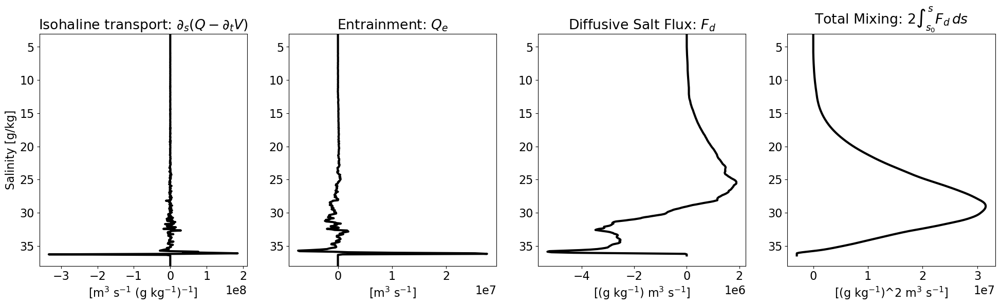

In [33]:
plt.rcParams.update({'font.size': 16})

fig, ax = plt.subplots(1,4 ,figsize = (24,6), dpi = 100)

(rhs).plot(ax = ax[0], 
           y = 'salt_bin', 
           ylim = (3,38),
           c = 'k',
           lw = 3)

ax[0].invert_yaxis()
ax[0].set_xlabel('')
# ax[0].set_title(r'$\frac{\partial Q}{\partial s}$ [m$^3$ s$^{-1}$ (g kg$^{-1}$)$^{-1}$]')
ax[0].set_ylabel('Salinity [g/kg]')

Qeint = ((rhs*ds)).cumsum('salt_bin')
Qeint.plot(ax = ax[1], 
           y = 'salt_bin', 
           ylim = (3,38),
           c = 'k',
           lw = 3)

ax[1].invert_yaxis()
ax[1].set_xlabel('')
# ax[1].set_title('$Q_e$ [m$^3$ s$^{-1}$]')
ax[1].set_ylabel('')

Fmint = (Qeint*ds)[:455].cumsum('salt_bin')
Fmint.plot(ax = ax[2], 
             y = 'salt_bin', 
             ylim = (3,38),
             c = 'k',
             lw = 3)

ax[2].invert_yaxis()
ax[2].set_xlabel('')
ax[2].set_ylabel('')

resmix = 2*((Fmint*ds).cumsum('salt_bin'))
resmix.plot(ax = ax[3], 
             y = 'salt_bin', 
             ylim = (3,38),
             c = 'k',
             lw = 3)

ax[3].invert_yaxis()
ax[3].set_xlabel('')
ax[3].set_ylabel('')
# ax[2].set_title(r'$\chi$ [m$^3$ s$^{-1}$ (g kg$^{-1}$)]')

ax[0].set_title(r'Isohaline transport: $\partial_s (Q- \partial_t V)$')
ax[1].set_title('Entrainment: $Q_e$')
ax[2].set_title(r'Diffusive Salt Flux: $F_d$')
ax[3].set_title(r'Total Mixing: 2$\int_{s_0}^{s} F_d \, ds$')

ax[0].set_xlabel(r'[m$^3$ s$^{-1}$ (g kg$^{-1}$)$^{-1}$]')
ax[1].set_xlabel('[m$^3$ s$^{-1}$]')
ax[2].set_xlabel('[(g kg$^{-1}$) m$^3$ s$^{-1}$]')
ax[3].set_xlabel(r'[(g kg$^{-1}$)^2 m$^3$ s$^{-1}$]')


(-10000000.0, 20000000.0)

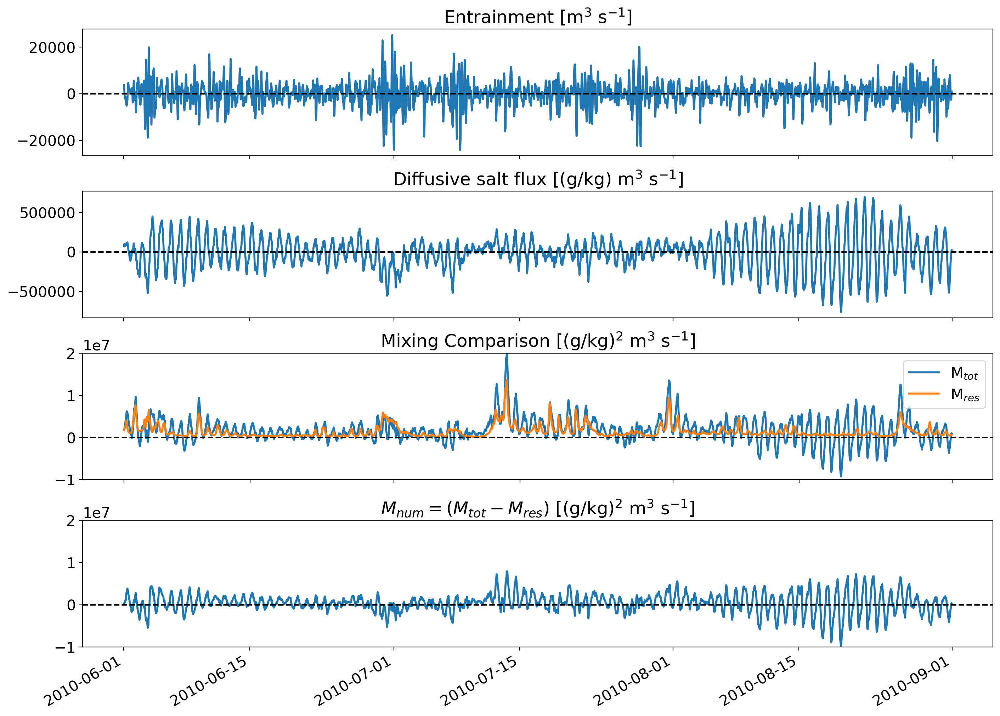

In [67]:
plt.rcParams.update({'font.size': 15})

fig, ax = plt.subplots(4, figsize = (14,10), constrained_layout = True, dpi = 200)

(Qeint1.sum('salt_bin')).plot(ax = ax[0], lw = 2)
(Fmint1.sum('salt_bin')).plot(ax = ax[1], lw = 2)

(resmix1.sum('salt_bin')).plot(ax = ax[2], lw = 2, label = r'M$_{tot}$')

(chislice.sum('salt_bin')).plot(ax = ax[2], lw = 2, label = r'M$_{res}$')

(resmix1.sum('salt_bin')-chislice.sum('salt_bin')).plot(ax = ax[3], lw = 2)

for axs in ax.reshape(-1): 
    axs.set_xlabel('')
    axs.set_ylabel('')
    
ax[0].set_title('Entrainment [m$^3$ s$^{-1}$]')
ax[0].axes.xaxis.set_ticklabels([])

ax[1].set_title('Diffusive salt flux [(g/kg) m$^3$ s$^{-1}$]')
ax[1].axes.xaxis.set_ticklabels([])

ax[2].set_title('Mixing Comparison [(g/kg)$^2$ m$^3$ s$^{-1}$]')
ax[2].legend()
ax[2].axes.xaxis.set_ticklabels([])

ax[3].set_title('$M_{num} = (M_{tot}-M_{res})$ [(g/kg)$^2$ m$^3$ s$^{-1}$]')

ax[0].axhline(y=0, color='k', linestyle='--')
ax[1].axhline(y=0, color='k', linestyle='--')
ax[2].axhline(y=0, color='k', linestyle='--')
ax[3].axhline(y=0, color='k', linestyle='--')

ax[2].set_ylim(-1e7, 2e7)
ax[3].set_ylim(-1e7, 2e7)
# ax.set_axhline(y=0, color='k', linestyle='--')

Text(0, 0.5, 'Salinity [g/kg]')

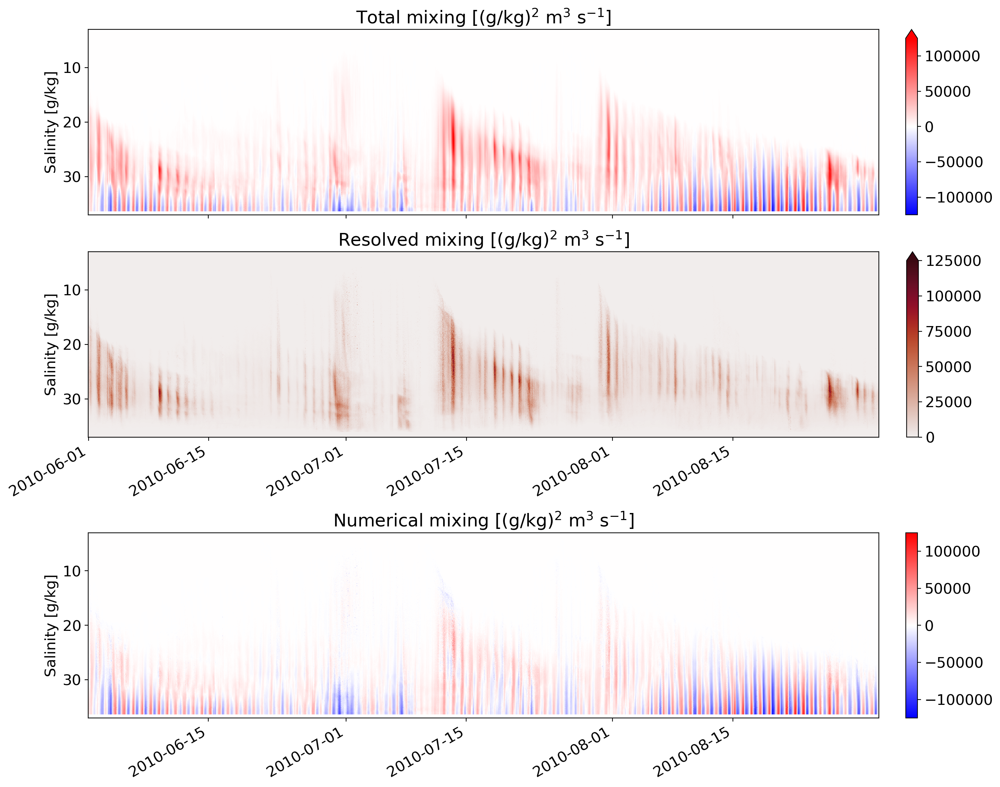

In [58]:
plt.rcParams.update({'font.size': 15})

fig, ax = plt.subplots(3, figsize = (14,11), constrained_layout = True, dpi = 200)

resmix1.plot(ax = ax[0],
             y = 'salt_bin', 
             cmap = plt.get_cmap('bwr'),
             vmax = 125000,
             cbar_kwargs = {'label': '',
                       'pad': 0.025})

chislice.plot(ax = ax[1],
             y = 'salt_bin', 
             cmap = cmo.amp,
             vmax = 125000,
             cbar_kwargs = {'label': '',
                       'pad': 0.025})

(resmix1-chislice).plot(ax = ax[2],
             y = 'salt_bin', 
             cmap = plt.get_cmap('bwr'),
             cbar_kwargs = {'label': '',
                       'pad': 0.025},
                       vmax = 125000)

for axs in ax.reshape(-1): 
    axs.set_ylabel('Salinity [g/kg]')
    axs.set_xlabel('')
    axs.set_ylim(3,37)
    
ax[0].invert_yaxis()
ax[0].set_title('Total mixing [(g/kg)$^2$ m$^3$ s$^{-1}$]')
ax[0].axes.xaxis.set_ticklabels([])

ax[1].invert_yaxis()
ax[1].set_xlabel('')
ax[1].set_title('Resolved mixing [(g/kg)$^2$ m$^3$ s$^{-1}$]')
ax[1].set_ylabel('Salinity [g/kg]')

ax[2].invert_yaxis()
ax[2].set_xlabel('')
ax[2].set_title('Numerical mixing [(g/kg)$^2$ m$^3$ s$^{-1}$]')
ax[2].set_ylabel('Salinity [g/kg]')

In [103]:
div6 = xr.open_dataset('statistics/Normalized_divergence_2010_6.nc').histogram_divergence
div7 = xr.open_dataset('statistics/Normalized_divergence_2010_7.nc').histogram_divergence
div8 = xr.open_dataset('statistics/Normalized_divergence_2010_8.nc').histogram_divergence

vort6 = xr.open_dataset('statistics/Normalized_vvort_2010_6.nc').histogram_relative_vorticity_n
vort7 = xr.open_dataset('statistics/Normalized_vvort_2010_7.nc').histogram_relative_vorticity_n
vort8 = xr.open_dataset('statistics/Normalized_vvort_2010_8.nc').histogram_relative_vorticity_n

strain6 = xr.open_dataset('statistics/Normalized_strain_2010_6.nc').histogram_strain
strain7 = xr.open_dataset('statistics/Normalized_strain_2010_7.nc').histogram_strain
strain8 = xr.open_dataset('statistics/Normalized_strain_2010_8.nc').histogram_strain

sgradmag6 = xr.open_dataset('statistics/Normalized_sgradmag_2010_6.nc').histogram_salgrad_mag
sgradmag7 = xr.open_dataset('statistics/Normalized_sgradmag_2010_7.nc').histogram_salgrad_mag
sgradmag8 = xr.open_dataset('statistics/Normalized_sgradmag_2010_8.nc').histogram_salgrad_mag

Text(0.5, 1.0, 'Salinity Gradient Magnitude')

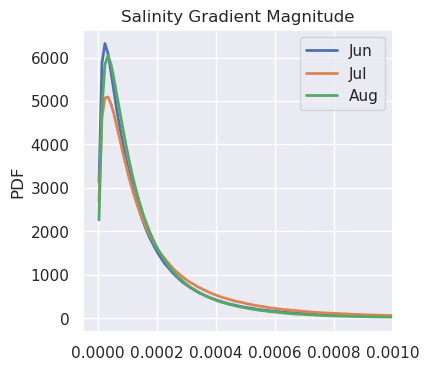

In [110]:
fig, ax = plt.subplots(1,1, figsize = (12/3,4), dpi = 100)

sgradmag6.plot(xlim = (-0.00005,0.001), lw = 2, label = 'Jun')
sgradmag7.plot(xlim = (-0.00005,0.001), lw = 2, label = 'Jul')
sgradmag8.plot(xlim = (-0.00005,0.001), lw = 2, label = 'Aug')

plt.xlabel('')
plt.ylabel('PDF')
plt.legend()
plt.title('Salinity Gradient Magnitude')

Text(0.5, 1.0, 'Salinity Gradient Magnitude')

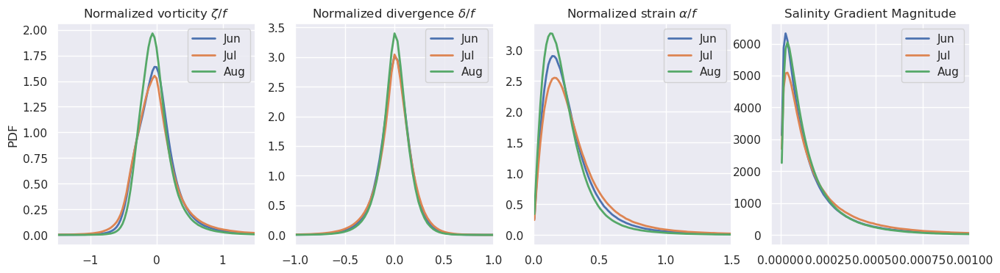

In [118]:
fig, ax = plt.subplots(1,4, figsize = (16,4), dpi = 100)

vort6.plot(ax = ax[0], xlim = (-1.5,1.5), lw = 2, label = 'Jun')
vort7.plot(ax = ax[0], xlim = (-1.5,1.5), lw = 2, label = 'Jul')
vort8.plot(ax = ax[0], xlim = (-1.5,1.5), lw = 2, label = 'Aug')

div6.plot(ax = ax[1], xlim = (-1,1), lw = 2, label = 'Jun')
div7.plot(ax = ax[1], xlim = (-1,1), lw = 2, label = 'Jul')
div8.plot(ax = ax[1], xlim = (-1,1), lw = 2, label = 'Aug')

strain6.plot(ax = ax[2], xlim = (0,1.5), lw = 2, label = 'Jun')
strain7.plot(ax = ax[2], xlim = (0,1.5), lw = 2, label = 'Jul')
strain8.plot(ax = ax[2], xlim = (0,1.5), lw = 2, label = 'Aug')

sgradmag6.plot(ax = ax[3], xlim = (-0.00005,0.001), lw = 2, label = 'Jun')
sgradmag7.plot(ax = ax[3], xlim = (-0.00005,0.001), lw = 2, label = 'Jul')
sgradmag8.plot(ax = ax[3], xlim = (-0.00005,0.001), lw = 2, label = 'Aug')

ax[0].set_title('Normalized vorticity $\zeta /f$')
ax[0].set_xlabel('')
ax[0].set_ylabel('PDF')
ax[0].legend()

ax[1].set_title('Normalized divergence $\delta /f$')
ax[1].set_xlabel('')
ax[1].set_ylabel('')
ax[1].legend()

ax[2].set_title(r'Normalized strain $\alpha /f$')
ax[2].set_xlabel('')
ax[2].set_ylabel('')
ax[2].legend()

ax[3].set_xlabel('')
ax[3].set_ylabel('')
ax[3].legend()
ax[3].set_title('Salinity Gradient Magnitude')

In [127]:
print('Jun: Median =','%.3f' %vort6.median().values)
print('Jul: Median =','%.3f' %vort7.median().values)
print('Aug: Median =','%.3f' %vort8.median().values)

print('Jun: STD =','%.3f' %vort6.std().values)
print('Jul: STD =','%.3f' %vort7.std().values)
print('Aug: STD =','%.3f' %vort8.std().values)

print('Jun: Skew=','%.3f' %skewness(vort6.mean().values, vort6.median().values, vort6.std().values))
print('Jul: Skew=','%.3f' %skewness(vort7.mean().values, vort7.median().values, vort7.std().values))
print('Aug: Skew=','%.3f' %skewness(vort8.mean().values, vort8.median().values, vort8.std().values))

Jun: Median = 0.003
Jul: Median = 0.008
Aug: Median = 0.001
Jun: STD = 0.385
Jul: STD = 0.365
Aug: STD = 0.427
Jun: Skew= 1.272
Jul: Skew= 1.306
Aug: Skew= 1.161


In [126]:
print('Jun: Median =','%.3f' %div6.median().values)
print('Jul: Median =','%.3f' %div7.median().values)
print('Aug: Median =','%.3f' %div8.median().values)

print('Jun: STD =','%.3f' %div6.std().values)
print('Jul: STD =','%.3f' %div7.std().values)
print('Aug: STD =','%.3f' %div8.std().values)

print('Jun: Skew=','%.3f' %skewness(div6.mean().values, div6.median().values, div6.std().values))
print('Jul: Skew=','%.3f' %skewness(div7.mean().values, div7.median().values, div7.std().values))
print('Aug: Skew=','%.3f' %skewness(div8.mean().values, div8.median().values, div8.std().values))

Jun: Median = 0.000
Jul: Median = 0.000
Aug: Median = 0.000
Jun: STD = 0.538
Jul: STD = 0.524
Aug: STD = 0.568
Jun: Skew= 0.929
Jul: Skew= 0.954
Aug: Skew= 0.880


In [125]:
print('Jun: Median =','%.3f' %strain6.median().values)
print('Jul: Median =','%.3f' %strain7.median().values)
print('Aug: Median =','%.3f' %strain8.median().values)

print('Jun: STD =','%.3f' %strain6.std().values)
print('Jul: STD =','%.3f' %strain7.std().values)
print('Aug: STD =','%.3f' %strain8.std().values)

print('Jun: Skew=','%.3f' %skewness(strain6.mean().values, strain6.median().values, strain6.std().values))
print('Jul: Skew=','%.3f' %skewness(strain7.mean().values, strain7.median().values, strain7.std().values))
print('Aug: Skew=','%.3f' %skewness(strain8.mean().values, strain8.median().values, strain8.std().values))

Jun: Median = 0.012
Jul: Median = 0.021
Aug: Median = 0.006
Jun: STD = 0.725
Jul: STD = 0.665
Aug: STD = 0.785
Jun: Skew= 1.332
Jul: Skew= 1.408
Aug: Skew= 1.252


In [124]:
print('Jun: Median =','%.3f' %sgradmag6.median().values)
print('Jul: Median =','%.3f' %sgradmag7.median().values)
print('Aug: Median =','%.3f' %sgradmag8.median().values)

print('Jun: STD =','%.3f' %sgradmag6.std().values)
print('Jul: STD =','%.3f' %sgradmag7.std().values)
print('Aug: STD =','%.3f' %sgradmag8.std().values)

print('Jun: Skew=','%.3f' %skewness(sgradmag6.mean().values, sgradmag6.median().values, sgradmag6.std().values))
print('Jul: Skew=','%.3f' %skewness(sgradmag7.mean().values, sgradmag7.median().values, sgradmag7.std().values))
print('Aug: Skew=','%.3f' %skewness(sgradmag8.mean().values, sgradmag8.median().values, sgradmag8.std().values))

Jun: Median = 40.714
Jul: Median = 57.897
Aug: Median = 24.122
Jun: STD = 1187.661
Jul: STD = 1058.569
Aug: STD = 1200.446
Jun: Skew= 1.160
Jul: Skew= 1.253
Aug: Skew= 1.189


In [95]:
def skewness(mean, median, std):
    skewness = (3*(mean-median))/std
    
    return skewness

print(skewness(strain6.mean().values, strain6.median().values, strain6.std().values))
print(skewness(strain7.mean().values, strain7.median().values, strain7.std().values))
print(skewness(strain8.mean().values, strain8.median().values, strain8.std().values))

print(skewness(div6.mean().values, div6.median().values, div6.std().values))
print(skewness(div7.mean().values, div7.median().values, div7.std().values))
print(skewness(div8.mean().values, div8.median().values, div8.std().values))

print(skewness(vort6.mean().values, vort6.median().values, vort6.std().values))
print(skewness(vort7.mean().values, vort7.median().values, vort7.std().values))
print(skewness(vort8.mean().values, vort8.median().values, vort8.std().values))

1.3317231099835833
1.4077256805168095
1.2517963839542032
0.9290440641970628
0.9536229265760973
0.8803637300614544
1.2719026923035959
1.3059511530007144
1.1610406552202708
